# 🛥️ **Árvores de Decisão** 🛥️
Este projeto utiliza técnicas de aprendizado de máquina para prever a sobrevivência de passageiros do Titanic, empregando Árvores de Decisão e Random Forest com dados fornecidos pelo Kaggle.

*   🗂️: Sistemas Inteligentes (IF684 - EC)
*   **Grupo 2 - Integrantes**
  - Bianca Duarte Santos (bds)
  - Dara Caroline de Souza Vasconcelos (dcsv)
  - Maria Eduarda Nunes de Almeida (mena)
  - Rafael da Silva Barros (rsb7)
  - Yasmim Vitória Silva de Oliveira (yvso)


## Bibliotecas

In [ ]:
! pip install optuna
! pip install tabulate

In [ ]:
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from tabulate import tabulate, tabulate_formats


from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import accuracy_score
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import classification_report, confusion_matrix,  accuracy_score
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV, cross_val_score, learning_curve, KFold, StratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier


from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import LabelEncoder, StandardScaler
from copy import deepcopy


from sklearn.utils._testing import ignore_warnings
from sklearn.exceptions import ConvergenceWarning
from sklearn.neighbors import KNeighborsRegressor
from imblearn.over_sampling import RandomOverSampler
from sklearn import tree


## Github repositório Titanic-db

In [ ]:
! git clone https://github.com/yasmimvso/titanic-db.git

fatal: destination path 'titanic-db' already exists and is not an empty directory.


In [ ]:
file = "/content/titanic-db/titanic/train.csv"

db_titanic =  pd.read_csv(file)


## Functions



In [ ]:
def plot_validation_error_vs_epoch(model, string, X_t, y_t, max_epochs=100):
    X_train, X_val, y_train, y_val = train_test_split(X_t, y_t, test_size=0.2, random_state=42)
    validation_errors = []

    # Deep copy do modelo para preservar o estado inicial
    model = deepcopy(model)

    # Função para treinar por uma época e calcular o erro de validação
    def train_and_record_error(model, X_train, y_train, X_val, y_val, errors_list):
        model.partial_fit(X_train, y_train, classes=np.unique(y_train))
        y_val_pred = model.predict(X_val)
        validation_error = 1 - accuracy_score(y_val, y_val_pred)
        errors_list.append(validation_error)

    for epoch in range(max_epochs):
        train_and_record_error(model, X_train, y_train, X_val, y_val, validation_errors)

    # Plotar o erro de validação em função das épocas
    plt.figure(figsize=(12, 8))
    plt.plot(range(1, max_epochs + 1), validation_errors, label='Validation Error', marker='o')
    plt.title(string)
    plt.xlabel('Epoch')
    plt.ylabel('Validation Error')
    plt.grid(True)
    plt.legend()
    plt.show()

In [ ]:
def infoClassificador(model, test_y, test_X):

  ##  Acurácia, Precision e Recall.

  pred_y = model.predict(test_X)

  # Medindo a acurácia do modelo
  accuracy = accuracy_score(test_y, pred_y)

  print(f"\nAcurácia do modelo {accuracy}")

  # model.score(X_test, y_test)

  # Relatório de classificação do modelo
  print(f"Classification Report")
  print(classification_report(test_y, pred_y))

In [ ]:
def plot_confusion_matrix(string, modelo_ml, X_test, y_test):
  y_pred = modelo_ml.predict(X_test)
  # Create the confusion matrix
  cm = confusion_matrix(y_test, y_pred)
  cm_percentage = cm / cm.sum(axis=1, keepdims=True)

  # Create a heatmap of the confusion matrix
  labels = ["Não Sobreviveu", 'Sobreviveu']
  sns.heatmap(cm_percentage, annot=True, cmap="Greens", fmt=".2f", xticklabels=labels, yticklabels=labels)
  # Set the labels for the axes
  plt.xlabel('Predict')
  plt.ylabel("True")

  # Set the title of the plot
  plt.title(string)

  # Show the plot
  plt.show()

In [ ]:
def plot_validation_error(model, X_t, y_t, hidden_layer_sizes):
    # Dividir os dados em treinamento e validação
    X_train, X_val, y_train, y_val = train_test_split(X_t, y_t, test_size=0.2, random_state=42)
    validation_errors = []

    for size in hidden_layer_sizes:
        model.hidden_layer_sizes = size
        model.fit(X_train, y_train)
        y_val_pred = model.predict(X_val)
        validation_error = 1 - accuracy_score(y_val, y_val_pred)
        validation_errors.append(validation_error)

    # Plotar o erro de validação
    plt.figure(figsize=(10, 6))
    plt.plot([str(size) for size in hidden_layer_sizes], validation_errors, marker='o')
    plt.title('Validation Error vs. Hidden Layer Sizes')
    plt.xlabel('Hidden Layer Sizes')
    plt.ylabel('Validation Error')
    plt.grid(True)
    plt.show()

### **Gráfico - Árvore de Decisão**

In [ ]:
def plot_decision_tree(modelo_ml, X_train, class_names, figsize=(130, 50), filename="decision_tree.png"):
    """
    Plota uma árvore de decisão.

    Parâmetros:
    - modelo_ml: modelo de árvore de decisão treinado
    - feature_names: lista com os nomes das características (features)
    - class_names: lista com os nomes das classes alvo
    - figsize: tupla opcional para o tamanho da figura (largura, altura)
    """
    feature_names = X_train.columns.tolist()
    fig, ax = plt.subplots(figsize=figsize)
    _ = tree.plot_tree(modelo_ml,
                       feature_names=feature_names,
                       class_names=class_names,
                       filled=True,
                       fontsize=10,
                       proportion=True,
                       rounded=True,
                       node_ids=False,
                       ax=ax)
    fig.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()

### **Feature Importance**

Para avaliar o impacto das características individuais no treinamento do modelo, apresentamos o gráfico de feature importance para os modelos treinados. Esses gráficos são gerados utilizando a biblioteca scikit-learn, cujo cálculo pode ser encontrado no código fonte da biblioteca, conforme disposto no artigo [The Mathematics of Decision Trees, Random Forest and Feature Importance in Scikit-learn](https://towardsdatascience.com/the-mathematics-of-decision-trees-random-forest-and-feature-importance-in-scikit-learn-and-spark-f2861df67e3).
O cálculo definido em (9) utiliza as equações (6), (7) e (8). <br> <br>
$ni_j = w_jC_j - W_{left(j)}C_{left(j)} - W_{right(j)}C_{right(j)}$ (6),
<br><br>
Onde $ni_j$ é a importância do nó j, $w_j$ é o número ponderado de amostras que chegam ao nó j, $C_j$ é o valor de impureza do nó j, $left(j)$ é o nó filho da divisão à esquerda do nó j, $right(j)$ é o nó filho da divisão à direita do nó j. <br><br>
A Equação (6) quantifica a importância de cada nó dentro das árvores de decisão individuais utilizando a medida de impureza de Gini. Subsequentemente, a Equação (7) calcula a importância de cada característica dentro de cada árvore de decisão. Para facilitar a comparação, a Equação (8) normaliza os valores de importância das características obtidos a partir da Equação (7). <br><br>
$fi_i = \frac{\sum ni_j}{\sum ni_k}$ (7), <br>

Onde $fi_i$ é a importância da característica i, $ni_j$ é a importância do nó j e $\sum ni_k$ é a soma de $ni$ para todos os nós k.<br><br>
$norm fi_i = \frac{fi_i}{\sum fi_j}$ (8), <br>

Passando para o nível da Random Forest, a Equação (9) determina a importância final das características, calculando a média dos valores de importância das características em todas as árvores de decisão individuais dentro do conjunto. Essa medida agregada proporciona uma compreensão abrangente da contribuição geral de cada característica para o poder preditivo do modelo de Random Forest. <br>

$RaFo fi_i = \frac{ \sum norm fi_{i_j}}{T}$ (9), <br>
Onde $RaFo fi_i$ é a importância final da característica (a importância da característica i calculada a partir de todas as árvores no modelo de Random Forest), $norm fi_{i_j}$ é a importância normalizada da característica i na árvore j (equação \ref{eq: ft_norm}) e T é o número total de árvores.


In [ ]:
def plot_feature_importances(modelo_ml, X):
    importances = pd.Series(data=modelo_ml.feature_importances_, index=X.columns)
    importances = importances.sort_values(ascending=False)

    plt.figure(figsize=(12, 8))
    sns.barplot(x=importances, y=importances.index, hue=importances.index, palette='viridis', dodge=False, legend=False)

    plt.title('Importância de cada feature', fontsize=16)
    plt.xlabel('Importância', fontsize=14)
    plt.ylabel('Features', fontsize=14)

    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)

    plt.show()

# Análise de Dados

## Análise Geral

| Feature                                       | Variable    | Value Type                                       |   |
|-----------------------------------------------|-------------|--------------------------------------------------|---|
| Index (Starting from 1)                    | PassangerId | int
| Survival    (Target Variable)                         | Survived | binary
|Ticket Class | Pclass | 1: 1st; 2: 2nd; 3: 3rd
|Sex	| Sex	| categorical code (female or male)
|Age | Age | float(years)
| Number of Sibilings/spouses* | Sibsp | int
| Number of parents/children** | Parch | int
| Ticket |	Ticket | int
| Amount paid for the ticket	| Fare | float
|Cabin |	Cabin | string
| Port of Embarkation | Embarked	| categorial code (C: Cherbourg, Q: Queenstown, S: Southampton)

### Observações
Age:  A idade é fracionada se for menor que 1. Se a idade for estimada, está na forma de xx.5
#### Relações Familiares
O dataset define relações famiiares da seguinte forma:
<br>
- \* Sibilings: irmão, irmã, meio-irmão, meia-irmã
<br>
- \** Spouses: marido, esposa (amantes e noivos foram ignorados)
<br>
-  Parent: mãe, pai
-  Child: filha, filho, enteada, enteado
<br>
Algumas crianças viajaram apenas com uma babá, portanto parch=0 para elas.

In [ ]:
display(db_titanic)

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.0,1,0,A/5 21171,7.2500,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.0,1,0,PC 17599,71.2833,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.0,0,0,STON/O2. 3101282,7.9250,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.0,1,0,113803,53.1000,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.0,0,0,373450,8.0500,NaN,S
...,...,...,...,...,...,...,...,...,...,...,...,...
886,887,0,2,"Montvila, Rev. Juozas",male,27.0,0,0,211536,13.0000,NaN,S
887,888,1,1,"Graham, Miss. Margaret Edith",female,19.0,0,0,112053,30.0000,B42,S
888,889,0,3,"Johnston, Miss. Catherine Helen ""Carrie""",female,NaN,1,2,W./C. 6607,23.4500,NaN,S
889,890,1,1,"Behr, Mr. Karl Howell",male,26.0,0,0,111369,30.0000,C148,C


In [ ]:
#Análise Estatística dos Dados
db_titanic.describe()

,PassengerId,Survived,Pclass,Age,SibSp,Parch,Fare
count,891.000000,891.000000,891.000000,714.000000,891.000000,891.000000,891.000000
mean,446.000000,0.383838,2.308642,29.699118,0.523008,0.381594,32.204208
std,257.353842,0.486592,0.836071,14.526497,1.102743,0.806057,49.693429
min,1.000000,0.000000,1.000000,0.420000,0.000000,0.000000,0.000000
25%,223.500000,0.000000,2.000000,20.125000,0.000000,0.000000,7.910400
50%,446.000000,0.000000,3.000000,28.000000,0.000000,0.000000,14.454200
75%,668.500000,1.000000,3.000000,38.000000,1.000000,0.000000,31.000000
max,891.000000,1.000000,3.000000,80.000000,8.000000,6.000000,512.329200


In [ ]:
print('Tipos de Dados:')
db_titanic.info()

print('\nNúmero de linhas e colunas:')
db_titanic.shape

Tipos de Dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 891 entries, 0 to 890
Data columns (total 12 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   PassengerId  891 non-null    int64  
 1   Survived     891 non-null    int64  
 2   Pclass       891 non-null    int64  
 3   Name         891 non-null    object 
 4   Sex          891 non-null    object 
 5   Age          714 non-null    float64
 6   SibSp        891 non-null    int64  
 7   Parch        891 non-null    int64  
 8   Ticket       891 non-null    object 
 9   Fare         891 non-null    float64
 10  Cabin        204 non-null    object 
 11  Embarked     889 non-null    object 
dtypes: float64(2), int64(5), object(5)
memory usage: 83.7+ KB

Número de linhas e colunas:


(891, 12)

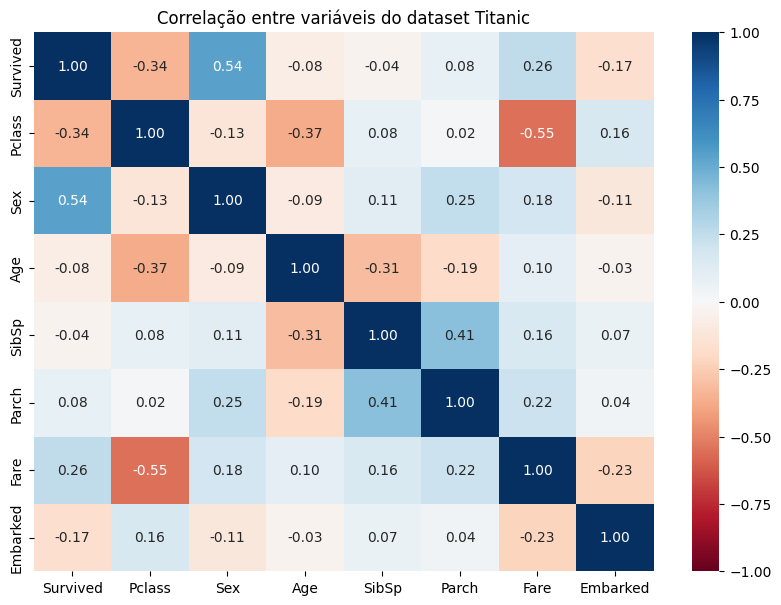

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(10, 7))
df  = db_titanic
#Excluir variáveis categoricas
df = df.drop(['Name', 'Ticket', 'Cabin', 'PassengerId'], axis=1)
#Converter male para 0 e female para 1
df['Sex'] = df['Sex'].map({'male': 0, 'female': 1})
#Converter Embarked para 0, 1, 2
df['Embarked'] = df['Embarked'].map({'C': 0, 'Q': 1, 'S': 2})
sns.heatmap(df.corr(),
            annot = True,
            fmt = '.2f',
            cmap='RdBu',
            vmin = -1.0,
            vmax = 1.0
            )
plt.title('Correlação entre variáveis do dataset Titanic')
plt.show()

In [ ]:
#Verificar a existência de valores nulos
db_titanic.isnull().sum()

Percebemos a presença de valores nulos em Embarked, Cabin e Age. Tomaremos as seguintes atitudes na Limpeza de Dados:
* A quantidade de valores nulos em Cabin é alta (77% da coluna em falta), logo, essa variável não será tão impactante no problema. Iremos removê-la.
* Para Embarked, apenas duas linhas tem valores nulos. Vamos eliminá-las.
* Para Age, 177 valores faltantes (19,86%). Por isso, vamos estimar esses valores. Utilizamos Regressão Linear para fazê-lo.

In [ ]:
print('Nome das colunas:')
db_titanic.columns

## Análise Exploratória

### Variáveis Numéricas

In [ ]:
# Contar a frequência de sobreviventes e não sobreviventes
survival_counts = db_titanic['Survived'].value_counts()

# Criar o gráfico de barras com cores mais leves
colors = ['lightcoral', 'lightgreen']
ax = survival_counts.plot(kind='bar', color=colors, edgecolor='black')

# Adicionar os valores em cada barra com um tamanho maior de fonte
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', xytext=(0, 8), textcoords='offset points', fontsize=12)

# Configurar o título
plt.title('Frequência de Sobreviventes no Titanic')
plt.xticks(ticks=[0, 1], labels=['Não Sobreviveu', 'Sobreviveu'], rotation=0)
plt.ylabel('Frequência')
plt.ylim(0, 700)

# Remover o rótulo do eixo x
ax.set_xlabel('')

#plt.figure(figsize=(14, 10))

plt.show()


In [ ]:

fig = make_subplots (rows=4, cols=1) #cria espaço com 4 linhas
fig.add_trace(go.Box(x=db_titanic['Age'], name = 'Idade'), row=1, col=1) #cria na primeira linha um boxplot sobre a idade dos pacientes
fig.add_trace(go.Box(x=db_titanic['SibSp'], name = 'Número de Irmãos/Conjuges'), row=2, col=1)
fig.add_trace(go.Box(x=db_titanic['Fare'], name = 'Valor do Bilhete'), row=3, col=1)
fig.add_trace(go.Box(x=db_titanic['Parch'], name = 'Número de Pais/Filhos'), row=4, col=1)
fig.update_layout(height = 800, template='plotly_dark')
fig.show()

###**Interpretação do BloxPlot**



1.   Idade (Idade):


*   Mediana: A mediana da idade está por volta dos 30 anos.
*   Quartis: O primeiro quartil (Q1) está por volta dos 20 anos, e o terceiro quartil (Q3) está por volta dos 40 anos.
*   Outliers: Existem alguns outliers em idades mais avançadas, especialmente acima de 70 anos.
*   Interpretação: A maioria dos passageiros tinha entre 20 e 40 anos, com poucos passageiros muito jovens ou muito idosos.


2.   Número de Irmãos/Cônjuges (SibSp):


*   Mediana: A mediana é 0, indicando que a maioria dos passageiros não estava viajando com irmãos ou cônjuges.
*   Quartis: O primeiro quartil é 0 e o terceiro quartil é 1.
*   Outliers: Existem vários outliers que indicam passageiros viajando com mais de 3 irmãos/cônjuges.
*   Interpretação: A maioria dos passageiros viajava sozinha ou com no máximo uma outra pessoa (irmão ou cônjuge), mas alguns viajavam com famílias maiores.

3. Valor do Bilhete (Fare):


*   Mediana: A mediana do valor do bilhete é bastante baixa, sugerindo que a maioria dos passageiros pagou menos de 100 unidades monetárias.
*   Quartis: O primeiro quartil é próximo de 0, e o terceiro quartil está abaixo de 100.
*   Outliers: Existem muitos outliers que pagaram acima de 200 unidades monetárias, chegando até mais de 500.
*   Interpretação: A maioria dos passageiros pagou pouco pelo bilhete, mas houve alguns que pagaram muito mais, indicando diferenças significativas nas condições de viagem (provavelmente classes diferentes).

4. Número de Pais/Filhos (Parch):


*   Mediana: A mediana é 0, indicando que a maioria dos passageiros não estava viajando com pais ou filhos.
*   Quartis: O primeiro quartil é 0 e o terceiro quartil é 0, indicando que 75% dos passageiros não estavam viajando com pais ou filhos.
*   Outliers: Existem alguns outliers com até 5 ou 6 pais/filhos.
*   Interpretação: A maioria dos passageiros não estava viajando com pais ou filhos, mas alguns viajavam com famílias mais numerosas.



##**Interpretações Gerais:**
Distribuição Etária: A maioria dos passageiros estava na faixa etária de 20 a 40 anos.
Estrutura Familiar: Muitos passageiros viajavam sozinhos ou apenas com um irmão/cônjuge, e poucos viajavam com pais ou filhos.
Custo da Viagem: O custo do bilhete variava amplamente, com a maioria pagando valores baixos e alguns pagando quantias significativamente mais altas.
Outliers: A presença de outliers em todas as variáveis sugere que havia uma diversidade significativa entre os passageiros em termos de idade, estrutura familiar e capacidade de pagar pela viagem.


In [ ]:


# Filtra os valores onde 'Age' é maior ou igual a 20.00
filtered_data = db_titanic.loc[db_titanic['Age'] >= 18.00]

# obtém a contagem de ocorrências de cada valor único na coluna "Parch"
contagem = filtered_data['Parch'].value_counts()

# separa os valores únicos e as contagens em listas separadas
valores_unicos = contagem.index.tolist()
frequencia = contagem.tolist()

# Example data
y_pos = np.arange(len(valores_unicos))
performance = contagem.tolist()
error = np.random.rand(len(valores_unicos))

# Cores diferentes para cada barra
colors = plt.cm.tab20(np.linspace(0, 1, len(valores_unicos)))



plt.figure(figsize=(12, 8))  # Aumenta o tamanho da figura
bars = plt.barh(y_pos, performance, xerr=error, align='center', height=0.7, color=colors, edgecolor='black')  # Muda a cor das barras

plt.yticks(y_pos, labels=valores_unicos, fontsize=12)
plt.gca().invert_yaxis()  # Inverte o eixo y
plt.xlabel('Frequência', fontsize=14)
plt.ylabel('Quantidade de Filhos', fontsize=14)
plt.title('Quantidade de Pais/Filhos (Idade >= 18)', fontsize=16)

# Adiciona os valores das frequências nas barras
for bar, value in zip(bars, performance):
    x_position = bar.get_width() + 5
    alignment = 'left'
    color = 'black'
    plt.text(x_position, bar.get_y() + bar.get_height()/2, str(value), ha=alignment, va='center', fontsize=12, color=color)

#plota o gráfico de barras

plt.show()


### Dados categóricos


In [ ]:
# Verificar os valores únicos e suas contagens na coluna 'Pclass'
print(db_titanic['Pclass'].value_counts())
print(db_titanic['Sex'].value_counts())
print(db_titanic['Embarked'].value_counts())
print(db_titanic['Survived'].value_counts())

In [ ]:
fig = make_subplots (rows=3, cols=1)
fig.add_trace(go.Bar(y= db_titanic['Pclass'].value_counts(), x = ['3ª classe', '1ª classe', '2ª classe'], name='Classe'), row=1, col=1)
fig.add_trace(go.Bar(y= db_titanic['Sex'].value_counts(), x = ['Masculino', 'Feminino'], name='Sexo'), row=2, col=1)
fig.add_trace(go.Bar(y= db_titanic['Embarked'].value_counts(), x = ['Southampton', 'Cherbourg', 'Queenstown'], name='Portão de Embarque'), row=3, col=1)
fig.update_layout(
    title={
        'text': "Análise de Variáveis Categóricas",
        'y': 0.95,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    template='plotly_dark',
    height=800,
    width=1000
)
fig.show()

In [ ]:
print(db_titanic.groupby(['Pclass', 'Survived']).count()['PassengerId'])
print(db_titanic.groupby(['Sex', 'Survived']).count()['PassengerId'])
print(db_titanic.groupby(['Embarked', 'Survived']).count()['PassengerId'])

In [ ]:
plt.figure(figsize=(8,6))
sns.countplot(data=db_titanic, x='Pclass', hue='Survived', palette={0: 'red', 1: 'lightgreen'})

plt.title("Frequência de Sobrevivência por Classe")
plt.xlabel('Classe Econômica')
plt.ylabel("Frequência")

plt.xticks(ticks=[0, 1, 2], labels=['1ª', '2ª', '3ª'])
plt.legend(title='Sobrevivência', labels=['Não Sobreviveu', 'Sobreviveu'])
plt.show()

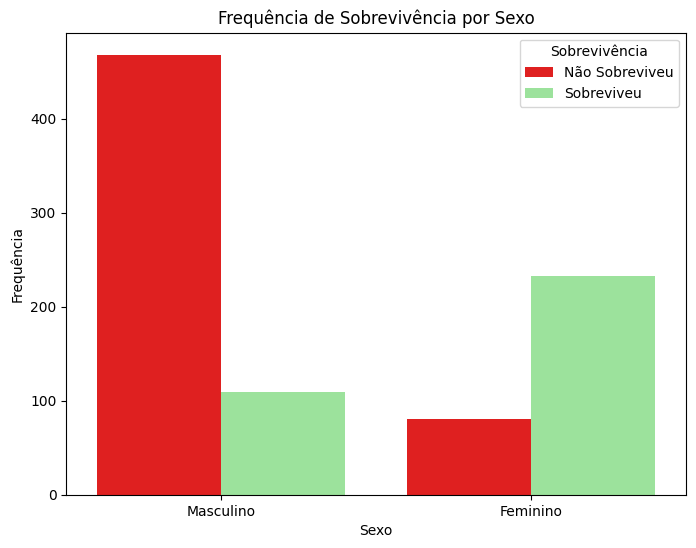

In [ ]:
plt.figure(figsize=(8,6))
sns.countplot(data=db_titanic, x='Sex', hue='Survived', palette={0: 'red', 1: 'lightgreen'})

plt.title("Frequência de Sobrevivência por Sexo")
plt.xlabel('Sexo')
plt.ylabel("Frequência")

plt.xticks(ticks=[0, 1], labels=['Masculino', 'Feminino'])
plt.legend(title='Sobrevivência', labels=['Não Sobreviveu', 'Sobreviveu'])
plt.show()

In [ ]:
plt.figure(figsize=(8,6))
sns.countplot(data=db_titanic, x='Embarked', hue='Survived', palette={0: 'red', 1: 'lightgreen'})

plt.title("Frequência de Sobrevivência por Portão de Embarque")
plt.xlabel('Portão de Embarque')
plt.ylabel("Frequência")

plt.xticks(ticks=[0, 1, 2], labels=[ 'Southampton', 'Cherbourg', 'Queenstown'])
plt.legend(title='Sobrevivência', labels=['Não Sobreviveu', 'Sobreviveu'])
plt.show()

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots

df = db_titanic

# Remover valores faltantes na coluna 'Age' e 'Survived'
df = df.dropna(subset=['Age', 'Survived']).copy()

# Calcular os valores máximos e mínimos da idade
age_min = df['Age'].min()
age_max = df['Age'].max()

# Definir classes de idade
bins = [0.0, 18.0, 60.0, age_max]  # max() + 1 para incluir o valor máximo no último bin
labels = ['Não Adulto', 'Adulto', 'Não Adulto']

# Categorizar idades
df['AgeClass'] = pd.cut(df['Age'], bins=bins, labels=labels, right=False, ordered=False)

# Bebês, Crianças, Adolescentes e Idosos -> Não Adultos
#df['AgeClass'] = df['AgeClass'].replace(['Bebês', 'Crianças', 'Adolescentes', 'Idosos'], 'Não Adultos')
#df[''] = pd.cut(df['Age'], bins=bins, labels=labels, include_lowest=True)

# Criar subplots
fig = make_subplots(rows=3, cols=1, subplot_titles=("Distribuição Geral", "Distribuição por Sexo: Masculino", "Distribuição por Sexo: Feminino"))

# Gráfico 1: Distribuição geral
for survived in [0, 1]:
    sub_df = df[df['Survived'] == survived]
    fig.add_trace(go.Bar(x=sub_df['AgeClass'].value_counts().index,
                         y=sub_df['AgeClass'].value_counts().values,
                         name=f'Sobreviveu: {survived}',
                         marker_color='lightgreen' if survived == 1 else 'red'),
                  row=1, col=1)

# Gráfico 2: Distribuição por sexo masculino
for survived in [0, 1]:
    sub_df = df[(df['Survived'] == survived) & (df['Sex'] == 'male')]
    fig.add_trace(go.Bar(x=sub_df['AgeClass'].value_counts().index,
                         y=sub_df['AgeClass'].value_counts().values,
                         name=f'Sobreviveu: {survived}',
                         marker_color='lightgreen' if survived == 1 else 'red',
                         showlegend=False),
                  row=2, col=1)

# Gráfico 3: Distribuição por sexo feminino
for survived in [0, 1]:
    sub_df = df[(df['Survived'] == survived) & (df['Sex'] == 'female')]
    fig.add_trace(go.Bar(x=sub_df['AgeClass'].value_counts().index,
                         y=sub_df['AgeClass'].value_counts().values,
                         name=f'Sobreviveu: {survived}',
                         marker_color='lightgreen' if survived == 1 else 'red',
                         showlegend=False),
                  row=3, col=1)

# Ajustar layout
fig.update_layout(title_text="Frequência de Sobrevivência entre Adultos e Não-Adultos por Sexo",
                  height=800, width=800)
fig.update_xaxes(title_text="Classe de Idade", row=1, col=1)
fig.update_xaxes(title_text="Classe de Idade", row=2, col=1)
fig.update_xaxes(title_text="Classe de Idade", row=3, col=1)
fig.update_yaxes(title_text="Frequência", row=1, col=1)
fig.update_yaxes(title_text="Frequência", row=2, col=1)
fig.update_yaxes(title_text="Frequência", row=3, col=1)

# Mostrar figura
fig.show()



In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots

df = db_titanic
# Remover valores faltantes na coluna 'Age' e 'Survived'
df = df.dropna(subset=['Age', 'Survived']).copy()

# Definir classes de idade
bins = [0, 18, 30, 60, df['Age'].max()]
labels = ['Não Adultos', 'Adultos 18-30', 'Adultos 30-60', 'Não Adultos']
df['AgeClass'] = pd.cut(df['Age'], bins=bins, labels=labels, include_lowest=True, right=False, ordered=False)

# Criar subplots
fig = make_subplots(rows=3, cols=1, subplot_titles=("Distribuição Geral", "Distribuição por Sexo: Masculino", "Distribuição por Sexo: Feminino"))

# Gráfico 1: Distribuição geral
for survived in [0, 1]:
    sub_df = df[df['Survived'] == survived]
    fig.add_trace(go.Bar(x=sub_df['AgeClass'].value_counts().index,
                         y=sub_df['AgeClass'].value_counts().values,
                         name=f'Sobreviveu: {survived}',
                         marker_color='lightgreen' if survived == 1 else 'red'),
                  row=1, col=1)

# Gráfico 2: Distribuição por sexo masculino
for survived in [0, 1]:
    sub_df = df[(df['Survived'] == survived) & (df['Sex'] == 'male')]
    fig.add_trace(go.Bar(x=sub_df['AgeClass'].value_counts().index,
                         y=sub_df['AgeClass'].value_counts().values,
                         name=f'Sobreviveu: {survived}',
                         marker_color='lightgreen' if survived == 1 else 'red',
                         showlegend=False),
                  row=2, col=1)

# Gráfico 3: Distribuição por sexo feminino
for survived in [0, 1]:
    sub_df = df[(df['Survived'] == survived) & (df['Sex'] == 'female')]
    fig.add_trace(go.Bar(x=sub_df['AgeClass'].value_counts().index,
                         y=sub_df['AgeClass'].value_counts().values,
                         name=f'Sobreviveu: {survived}',
                         marker_color='lightgreen' if survived == 1 else 'red',
                         showlegend=False),
                  row=3, col=1)

# Ajustar layout
fig.update_layout(title_text="Frequência de Sobrevivência por Não Adultos e Adultos (com 2 faixas) por Sexo",
                  height=800, width=800)
fig.update_xaxes(title_text="Classe de Idade", row=1, col=1)
fig.update_xaxes(title_text="Classe de Idade", row=2, col=1)
fig.update_xaxes(title_text="Classe de Idade", row=3, col=1)
fig.update_yaxes(title_text="Frequência", row=1, col=1)
fig.update_yaxes(title_text="Frequência", row=2, col=1)
fig.update_yaxes(title_text="Frequência", row=3, col=1)

# Mostrar figura
fig.show()

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots

df = db_titanic
# Remover valores faltantes na coluna 'Age' e 'Survived'
df = df.dropna(subset=['Age', 'Survived']).copy()

# Definir classes de idade
bins = [0, 18, 30, 40, 50, 60, df['Age'].max()]
labels = ['Não Adultos', 'Adultos 18-30', 'Adultos 30-40', 'Adultos 40-50', 'Adultos 50-60', 'Não Adultos']
df['AgeClass'] = pd.cut(df['Age'], bins=bins, labels=labels, include_lowest=True, right=False, ordered=False)

# Criar subplots
fig = make_subplots(rows=3, cols=1, subplot_titles=("Distribuição Geral", "Distribuição por Sexo: Masculino", "Distribuição por Sexo: Feminino"))

# Gráfico 1: Distribuição geral
for survived in [0, 1]:
    sub_df = df[df['Survived'] == survived]
    fig.add_trace(go.Bar(x=sub_df['AgeClass'].value_counts().index,
                         y=sub_df['AgeClass'].value_counts().values,
                         name=f'Sobreviveu: {survived}',
                         marker_color='lightgreen' if survived == 1 else 'red'),
                  row=1, col=1)

# Gráfico 2: Distribuição por sexo masculino
for survived in [0, 1]:
    sub_df = df[(df['Survived'] == survived) & (df['Sex'] == 'male')]
    fig.add_trace(go.Bar(x=sub_df['AgeClass'].value_counts().index,
                         y=sub_df['AgeClass'].value_counts().values,
                         name=f'Sobreviveu: {survived}',
                         marker_color='lightgreen' if survived == 1 else 'red',
                         showlegend=False),
                  row=2, col=1)

# Gráfico 3: Distribuição por sexo feminino
for survived in [0, 1]:
    sub_df = df[(df['Survived'] == survived) & (df['Sex'] == 'female')]
    fig.add_trace(go.Bar(x=sub_df['AgeClass'].value_counts().index,
                         y=sub_df['AgeClass'].value_counts().values,
                         name=f'Sobreviveu: {survived}',
                         marker_color='lightgreen' if survived == 1 else 'red',
                         showlegend=False),
                  row=3, col=1)

# Ajustar layout
fig.update_layout(title_text="Frequência de Sobrevivência por Não Adultos e Adultos (com 4 faixas) por Sexo",
                  height=800, width=800)
fig.update_xaxes(title_text="Classe de Idade", row=1, col=1)
fig.update_xaxes(title_text="Classe de Idade", row=2, col=1)
fig.update_xaxes(title_text="Classe de Idade", row=3, col=1)
fig.update_yaxes(title_text="Frequência", row=1, col=1)
fig.update_yaxes(title_text="Frequência", row=2, col=1)
fig.update_yaxes(title_text="Frequência", row=3, col=1)

# Mostrar figura
fig.show()


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots

df = db_titanic
# Remover valores faltantes na coluna 'Age' e 'Survived'
df = df.dropna(subset=['Age', 'Survived']).copy()

# Calcular os valores máximos e mínimos da idade
age_min = df['Age'].min()
age_max = df['Age'].max()

# Definir classes de idade
bins = [0, 2, 12, 17, 59, age_max]
labels = ['Bebês', 'Crianças', 'Adolescentes', 'Adultos', 'Idosos']
df['AgeClass'] = pd.cut(df['Age'], bins=bins, labels=labels, include_lowest=True)

# Criar subplots
fig = make_subplots(rows=3, cols=1, subplot_titles=("Distribuição Geral", "Distribuição por Sexo: Masculino", "Distribuição por Sexo: Feminino"))

# Gráfico 1: Distribuição geral
for survived in [0, 1]:
    sub_df = df[df['Survived'] == survived]
    fig.add_trace(go.Bar(x=sub_df['AgeClass'].value_counts().index,
                         y=sub_df['AgeClass'].value_counts().values,
                         name=f'Sobreviveu: {survived}',
                         marker_color='lightgreen' if survived == 1 else 'red'),
                  row=1, col=1)

# Gráfico 2: Distribuição por sexo masculino
for survived in [0, 1]:
    sub_df = df[(df['Survived'] == survived) & (df['Sex'] == 'male')]
    fig.add_trace(go.Bar(x=sub_df['AgeClass'].value_counts().index,
                         y=sub_df['AgeClass'].value_counts().values,
                         name=f'Sobreviveu: {survived}',
                         marker_color='lightgreen' if survived == 1 else 'red',
                         showlegend=False),
                  row=2, col=1)

# Gráfico 3: Distribuição por sexo feminino
for survived in [0, 1]:
    sub_df = df[(df['Survived'] == survived) & (df['Sex'] == 'female')]
    fig.add_trace(go.Bar(x=sub_df['AgeClass'].value_counts().index,
                         y=sub_df['AgeClass'].value_counts().values,
                         name=f'Sobreviveu: {survived}',
                         marker_color='lightgreen' if survived == 1 else 'red',
                         showlegend=False),
                  row=3, col=1)

# Ajustar layout
fig.update_layout(title_text="Frequência de Sobrevivência por Sexo e 5 Faixas de Idade",
                  height=800, width=800)
fig.update_xaxes(title_text="Classe de Idade", row=1, col=1)
fig.update_xaxes(title_text="Classe de Idade", row=2, col=1)
fig.update_xaxes(title_text="Classe de Idade", row=3, col=1)
fig.update_yaxes(title_text="Frequência", row=1, col=1)
fig.update_yaxes(title_text="Frequência", row=2, col=1)
fig.update_yaxes(title_text="Frequência", row=3, col=1)

# Mostrar figura
fig.show()

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots


df = db_titanic.copy()
# Remover valores faltantes na coluna 'Age' e 'Survived'
df = df.dropna(subset=['Age', 'Survived']).copy()

# Calcular os valores máximos e mínimos da idade
age_min = df['Age'].min()
age_max = df['Age'].max()

# Definir classes de idade
bins = [0, 2, 12, 17, 59, age_max]
labels = ['Bebês', 'Crianças', 'Adolescentes', 'Adultos', 'Idosos']
df['AgeClass'] = pd.cut(df['Age'], bins=bins, labels=labels, include_lowest=True)

# Reagrupar as classes de idade em três categorias: "Crianças+Bebês", "Idosos+Adolescentes" e "Adultos"
df['AgeGroup'] = df['AgeClass'].replace({
    'Bebês': 'Crianças+Bebês',
    'Crianças': 'Crianças+Bebês',
    'Adolescentes': 'Idosos+Adolescentes',
    'Idosos': 'Idosos+Adolescentes'
})

# Criar subplots
fig = make_subplots(rows=3, cols=1, subplot_titles=("Distribuição Geral", "Distribuição por Sexo: Masculino", "Distribuição por Sexo: Feminino"))

# Gráfico 1: Distribuição geral
for survived in [0, 1]:
    sub_df = df[df['Survived'] == survived]
    fig.add_trace(go.Bar(x=sub_df['AgeGroup'].value_counts().index,
                         y=sub_df['AgeGroup'].value_counts().values,
                         name=f'Sobreviveu: {survived}',
                         marker_color='lightgreen' if survived == 1 else 'red'),
                  row=1, col=1)

# Gráfico 2: Distribuição por sexo masculino
for survived in [0, 1]:
    sub_df = df[(df['Survived'] == survived) & (df['Sex'] == 'male')]
    fig.add_trace(go.Bar(x=sub_df['AgeGroup'].value_counts().index,
                         y=sub_df['AgeGroup'].value_counts().values,
                         name=f'Sobreviveu: {survived}',
                         marker_color='lightgreen' if survived == 1 else 'red',
                         showlegend=False),
                  row=2, col=1)

# Gráfico 3: Distribuição por sexo feminino
for survived in [0, 1]:
    sub_df = df[(df['Survived'] == survived) & (df['Sex'] == 'female')]
    fig.add_trace(go.Bar(x=sub_df['AgeGroup'].value_counts().index,
                         y=sub_df['AgeGroup'].value_counts().values,
                         name=f'Sobreviveu: {survived}',
                         marker_color='lightgreen' if survived == 1 else 'red',
                         showlegend=False),
                  row=3, col=1)

# Ajustar layout
fig.update_layout(title_text="Frequência de Sobrevivência por Sexo e Classes de Idade Agrupadas",
                  height=800, width=800)
fig.update_xaxes(title_text="Classe de Idade", row=1, col=1)
fig.update_xaxes(title_text="Classe de Idade", row=2, col=1)
fig.update_xaxes(title_text="Classe de Idade", row=3, col=1)
fig.update_yaxes(title_text="Frequência", row=1, col=1)
fig.update_yaxes(title_text="Frequência", row=2, col=1)
fig.update_yaxes(title_text="Frequência", row=3, col=1)

# Mostrar figura
fig.show()


# Engenharia de Dados


 -- Limpeza de dados:

 * A limpeza de dados foi utilizado para analizar os dados faltantes e corrompidos. Optamos por excluir a coluna Cabin, Ticket, Name, PassagerID por se tratar de dados com muito dados faltantes ou irrelevantes para o modelo

 * Por se tratar de um modelo de classificação de árvore, normalizamos os dados e os transformamos em numérico. Passo importante para o trainamento do modelo.

In [ ]:
# Seleção de informações mais relevantes em traino

# titanic_feature = db_titanic[['Pclass', 'Sex', 'Age', 'SibSp', 'Parch', 'Embarked', 'Survived']]
# # titanic_feature = db_titanic[['Pclass', 'Sex', 'Age', 'SibSp', 'Parch', 'Embarked', 'Fare']]

db_titanic = db_titanic.drop('Cabin', axis=1)
db_titanic = db_titanic.drop('Ticket', axis=1)
db_titanic = db_titanic.drop('Name', axis=1)
db_titanic = db_titanic.drop('PassengerId', axis=1)

# transformando de dados categóricos para numericos
db_titanic['Sex'] =  db_titanic['Sex'].map({'male': 0, 'female': 1})
db_titanic['Embarked'] =  db_titanic['Embarked'].map({'C': 0.0, 'Q': 0.5, 'S': 1.0})
# titanic_feature['Age'] = titanic_feature['Age'] /titanic_feature['Age'].abs().max()
db_titanic['Pclass'] = db_titanic['Pclass'].map({1: 0, 2: 0.5, 3: 1})
db_titanic['SibSp'] =  db_titanic['SibSp']/ db_titanic['SibSp'].abs().max()
db_titanic['Parch'] = db_titanic['Parch']/db_titanic['Parch'].abs().max()

db_titanic=  db_titanic[~db_titanic['Embarked'].isnull()] ## tirando as linhas corrompidas de Embarque



## Agrupamentos


Nesta Etapa destacamos o processo de agrupamento como processo imprescindível para o aprimoramento dos dados para o modelo. Tratamos os dados : Age, Fare, Parch e Sibs.

**Atenção** : Nessa etapa adicionaremos a etapa de análise de dados para os dados de Fare e (Parch,  SibSp), isso porque outrora Age já foi verificado e aprensentado. Para melhor visualizar, ir para seção : " Análise de Dados "

A conclusão que obtemos para os agrupamentos "Fare" que com valores mais altos, em torno de 150 - max, temos resultados similares, sua grande totalidade 1 classe, maiores taxas de sobrevivencia , e mortos do sexo masculino. Agrupamos com intervalos de 50 e 50 dado a particularidade analizando as duas visualizções.

In [ ]:
def normalize_fare(fare):
    if fare < 100 :
        return 0
    elif fare >= 100 and fare < 200 :
        return 0.5
    else:
        return 1

db_titanic['Fare'] = db_titanic['Fare'].apply(normalize_fare)

### Agrupamento Fare

In [ ]:
def normalize_fare(fare):
    if fare == '0-50':
        return 0
    elif fare == '50-100':
        return 0.25
    elif fare == '100-150':
       return 0.25
    else:
        return 1

max_value = db_titanic['Fare'].max()
bins = [0, 50, 100, 150, max_value]
labels = ['0-50', '50-100', '100-150', '150+']

db_titanic['Fare'] = pd.cut(db_titanic['Fare'], bins=bins, labels=labels, right=False)

db_titanic['Fare'] = db_titanic['Fare'].apply(normalize_fare)

db_titanic=  db_titanic[~db_titanic['Fare'].isnull()]
## normalizar os dados entre o e 1
display(db_titanic)

,Survived,Pclass,Sex,Age,SibSp,Parch,Fare,Embarked
0,0,1.0,0,22.0,0.125,0.000000,0.00,1.0
1,1,0.0,1,38.0,0.125,0.000000,0.25,0.0
2,1,1.0,1,26.0,0.000,0.000000,0.00,1.0
3,1,0.0,1,35.0,0.125,0.000000,0.25,1.0
4,0,1.0,0,35.0,0.000,0.000000,0.00,1.0
...,...,...,...,...,...,...,...,...
886,0,0.5,0,27.0,0.000,0.000000,0.00,1.0
887,1,0.0,1,19.0,0.000,0.000000,0.00,1.0
888,0,1.0,1,NaN,0.125,0.333333,0.00,1.0
889,1,0.0,0,26.0,0.000,0.000000,0.00,0.0


#### Análise de Dados Fare

Dado a reslação traçada por feature importance, podemos estabelecer uma análise entre os valores de maiores relevancias para o modelo: Age e Pclass

-- Relação de comparação entre Fare e Pclass, optamos por granular os dados de modo a análisar os resultados a cada intervalo.

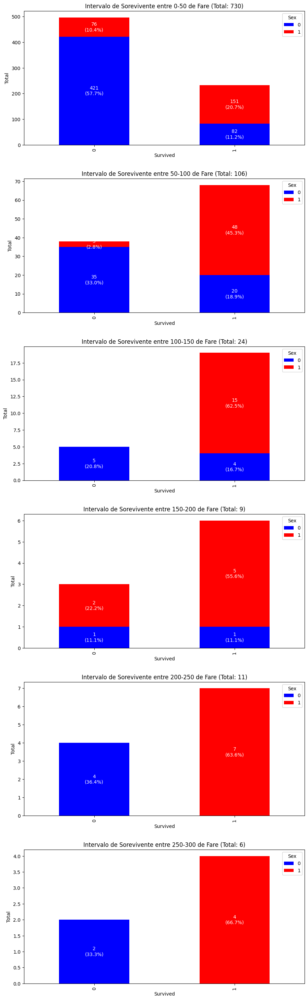

In [ ]:
bins = [0, 50, 100, 150, 200, 250, 300]
labels = ['0-50', '50-100', '100-150', '150-200', '200-250', '250-300']

# Criando uma nova coluna com os intervalos de tarifa
db_titanic['Fare_Range'] = pd.cut(db_titanic['Fare'], bins=bins, labels=labels, right=False)


fig, axs = plt.subplots(len(labels), 1, figsize=(10, 30))
fig.tight_layout(pad=5.0)

for i, fare_range in enumerate(labels):
    # Filtrando os dados pelo intervalo de tarifa
    fare_data = db_titanic[db_titanic['Fare_Range'] == fare_range]

    # Contando os sobreviventes e não sobreviventes por sexo
    fare_counts = fare_data.groupby(['Survived', 'Sex']).size().unstack(fill_value=0)

    total = fare_counts.sum().sum()
    percentages = fare_counts.div(total).mul(100)

    # Criando o gráfico de barras empilhadas
    fare_counts.plot(kind='bar', stacked=True, ax=axs[i], color=['blue', 'red'])

    # Adicionando as porcentagens acima das barras
    for bar in axs[i].patches:
        height = bar.get_height()
        if height > 0:
            axs[i].annotate(f'{height:.0f}\n({height/total*100:.1f}%)',
                        (bar.get_x() + bar.get_width() / 2, bar.get_y() + height / 2),
                        ha='center', va='center', color='white', fontsize=10)

    axs[i].set_title(f'Intervalo de Sorevivente entre {fare_range} de Fare (Total: {total})')
    axs[i].set_ylabel('Total')

plt.show()



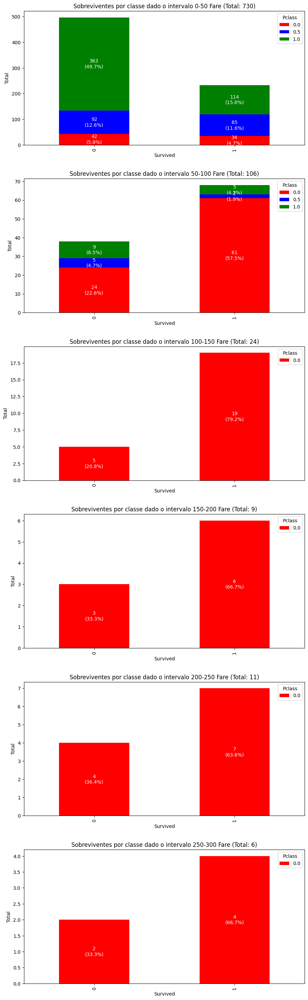

In [ ]:
bins = [0, 50, 100, 150, 200, 250, 300]
labels = ['0-50', '50-100', '100-150', '150-200', '200-250', '250-300']

db_titanic['Fare_Range'] = pd.cut(db_titanic['Fare'], bins=bins, labels=labels, right=False)

# Criando a figura e os eixos
fig, axs = plt.subplots(len(labels), 1, figsize=(10, 30))
fig.tight_layout(pad=5.0)

for i, fare_range in enumerate(labels):
    # filtrando os dados pelo intervalo de tarifa
    fare_data = db_titanic[db_titanic['Fare_Range'] == fare_range]

    # Contando os sobreviventes e não sobreviventes por classe
    fare_counts = fare_data.groupby(['Survived', 'Pclass']).size().unstack(fill_value=0)

    total = fare_counts.sum().sum()
    percentages = fare_counts.div(total).mul(100)

    fare_counts.plot(kind='bar', stacked=True, ax=axs[i], color=['red', 'blue', 'green'])

    # Adicionando as porcentagens acima das barras
    for bar in axs[i].patches:
        height = bar.get_height()
        if height > 0:
            axs[i].annotate(f'{height:.0f}\n({height/total*100:.1f}%)',
                        (bar.get_x() + bar.get_width() / 2, bar.get_y() + height / 2),
                        ha='center', va='center', color='white', fontsize=10)

    # Configurando o título e rótulos
    axs[i].set_title(f'Sobreviventes por classe dado o intervalo {fare_range} Fare (Total: {total})')
    axs[i].set_ylabel('Total')

plt.show()

###Agrupamento entre Parch e SibSp

Estamos realizando esse agrupamento para entender como a estrutura familiar dos passageiros do Titanic influenciou suas chances de sobrevivência. Ao categorizar passageiros com base no número de pais/filhos (Parch) e irmãos/cônjuges (SibSp), podemos identificar padrões e grupos semelhantes. Analisando a taxa de sobrevivência de cada grupo, podemos descobrir se passageiros com familiares tinham mais ou menos chance de sobrevivência comparados aos que estavam sozinhos. Essa análise ajuda a avaliar o impacto da presença de familiares na sobrevivência e a entender melhor os fatores que influenciaram o desfecho do desastre.



In [ ]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# Carregar o dataset (substitua pelo caminho correto do seu dataset)
# df = pd.read_csv('titanic.csv')

# Passo 1: Criar a nova variável combinada
db_titanic['total_relatives'] = db_titanic['Parch'] + db_titanic['SibSp']

# Normalizar a nova variável combinada usando Min-Max Scaler
scaler = MinMaxScaler()
db_titanic['total_relatives'] = scaler.fit_transform(db_titanic[['total_relatives']])


# Passo 2: Categorizar a nova variável normalizada
def categorize_total_relatives_normalized(relatives):
    return 0 if relatives == 0 else 1

db_titanic['family_group'] = db_titanic['total_relatives'].apply(categorize_total_relatives_normalized)

# Visualizar a nova coluna normalizada
print(db_titanic[['Parch', 'SibSp', 'total_relatives', 'total_relatives', 'family_group']].head())

# Passo 3: Análise das novas variáveis normalizadas
# Taxa de sobrevivência por grupo familiar normalizado
survival_by_family_group_normalized = db_titanic.groupby('family_group')['Survived'].mean()
print(survival_by_family_group_normalized)

# Contagem de passageiros por grupo familiar normalizado
count_by_family_group_normalized = db_titanic['family_group'].value_counts()
print(count_by_family_group_normalized)

   Parch  SibSp  total_relatives  total_relatives  family_group
0    0.0  0.125          0.09375          0.09375             1
1    0.0  0.125          0.09375          0.09375             1
2    0.0  0.000          0.00000          0.00000             0
3    0.0  0.125          0.09375          0.09375             1
4    0.0  0.000          0.00000          0.00000             0
family_group
0    0.298311
1    0.504249
Name: Survived, dtype: float64
family_group
0    533
1    353
Name: count, dtype: int64


<ipython-input-355-6c90e1a7d3ee>:6: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='family_group', y='Survived', data=db_titanic, ci=None)


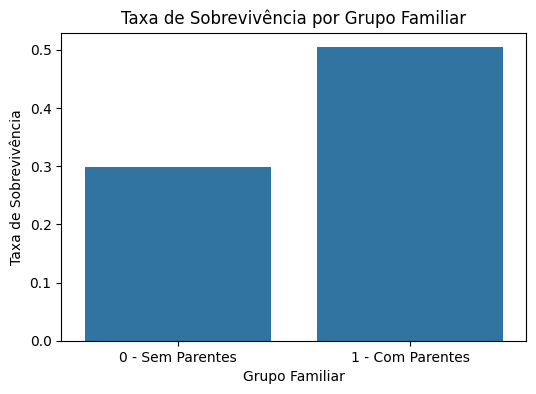

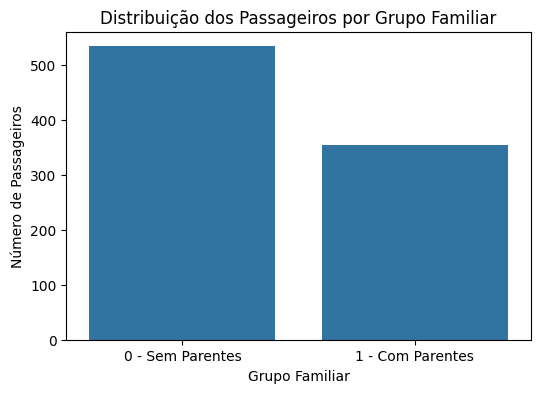

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Barplot da taxa de sobrevivência por grupo familiar
plt.figure(figsize=(6, 4))
sns.barplot(x='family_group', y='Survived', data=db_titanic, ci=None)
plt.title('Taxa de Sobrevivência por Grupo Familiar')
plt.xlabel('Grupo Familiar')
plt.ylabel('Taxa de Sobrevivência')
plt.xticks(ticks=[0, 1], labels=['0 - Sem Parentes', '1 - Com Parentes'])
plt.show()

# Histograma da distribuição dos passageiros por grupo familiar
plt.figure(figsize=(6, 4))
sns.countplot(x='family_group', data=db_titanic)
plt.title('Distribuição dos Passageiros por Grupo Familiar')
plt.xlabel('Grupo Familiar')
plt.ylabel('Número de Passageiros')
plt.xticks(ticks=[0, 1], labels=['0 - Sem Parentes', '1 - Com Parentes'])
plt.show()

####Conclusões Possíveis Impacto Familiar na Sobrevivência:

- Observamos que o grupo com parentes teve uma taxa de sobrevivência maior do que o grupo sem parentes, mesmo que o segundo gráfico mostre que o grupo sem parentes apresenta um número maior de pessoas.


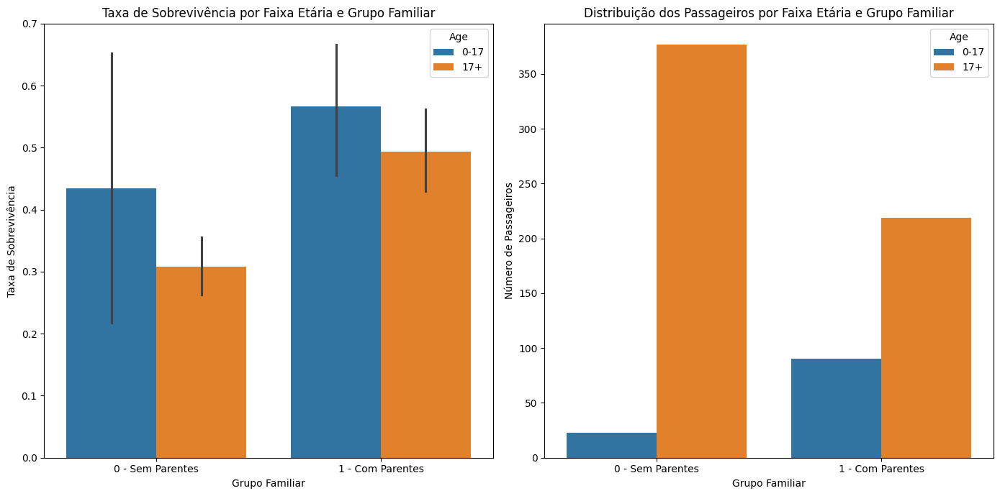

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler



# Passo 1: Criar a nova variável combinada
db_titanic['total_relatives'] = db_titanic['Parch'] + db_titanic['SibSp']

# Normalizar a nova variável combinada usando Min-Max Scaler
scaler = MinMaxScaler()
db_titanic['total_relatives'] = scaler.fit_transform(db_titanic[['total_relatives']])

# Passo 2: Categorizar a nova variável normalizada
def categorize_total_relatives_normalized(relatives):
    return 0 if relatives == 0 else 1

db_titanic['family_group'] = db_titanic['total_relatives'].apply(categorize_total_relatives_normalized)

# Visualizações
plt.figure(figsize=(14, 7))

# Taxa de sobrevivência por faixa etária e grupo familiar
plt.subplot(1, 2, 1)
sns.barplot(
    x='family_group',
    y='Survived',
    hue=pd.cut(db_titanic['Age'], bins=[0, 17, db_titanic['Age'].max()], labels=['0-17', '17+']),
    data=db_titanic,
    estimator=lambda x: x.mean()  # Média da taxa de sobrevivência
)
plt.title('Taxa de Sobrevivência por Faixa Etária e Grupo Familiar')
plt.xlabel('Grupo Familiar')
plt.ylabel('Taxa de Sobrevivência')
plt.xticks(ticks=[0, 1], labels=['0 - Sem Parentes', '1 - Com Parentes'])

# Distribuição dos passageiros por faixa etária e grupo familiar
plt.subplot(1, 2, 2)
sns.countplot(
    x='family_group',
    hue=pd.cut(db_titanic['Age'], bins=[0, 17, db_titanic['Age'].max()], labels=['0-17', '17+']),
    data=db_titanic
)
plt.title('Distribuição dos Passageiros por Faixa Etária e Grupo Familiar')
plt.xlabel('Grupo Familiar')
plt.ylabel('Número de Passageiros')
plt.xticks(ticks=[0, 1], labels=['0 - Sem Parentes', '1 - Com Parentes'])
plt.tight_layout()
plt.show()


####Taxa de Sobrevivência por faixa etária por Composição Familiar:

 - A taxa de sobrevivência por faixa etária mostra que, em ambos os grupos, a taxa de sobrevivência foi predominante para as pessoas mais jovens, com uma diferença pequena de até no máximo 0,1%. No entanto, ao considerarmos a distribuição dos passageiros por faixa etária, percebemos que o grupo de pessoas 'não-adultas' é substancialmente menor que o grupo de adultos, o que faz com que a quantidade de sobreviventes 'não-adultos' seja relativamente maior.

In [ ]:
db_titanic.head(30)

,Survived,Pclass,Sex,Age,SibSp,Parch,Fare,Embarked,total_relatives,family_group
0,0,1.0,0,22.0,0.125,0.000000,0.0,1.0,0.09375,1
1,1,0.0,1,38.0,0.125,0.000000,0.0,0.0,0.09375,1
2,1,1.0,1,26.0,0.000,0.000000,0.0,1.0,0.00000,0
3,1,0.0,1,35.0,0.125,0.000000,0.0,1.0,0.09375,1
4,0,1.0,0,35.0,0.000,0.000000,0.0,1.0,0.00000,0
5,0,1.0,0,NaN,0.000,0.000000,0.0,0.5,0.00000,0
6,0,0.0,0,54.0,0.000,0.000000,0.0,1.0,0.00000,0
7,0,1.0,0,2.0,0.375,0.166667,0.0,1.0,0.40625,1
8,1,1.0,1,27.0,0.000,0.333333,0.0,1.0,0.25000,1
9,1,0.5,1,14.0,0.125,0.000000,0.0,0.0,0.09375,1


## Tratando variáveis

Essa opção, considera a escolha dos tratamentos de Parch e SibSp

In [ ]:
data_X = db_titanic[~db_titanic['Age'].isnull()][['Pclass', 'SibSp', 'Parch', 'Embarked', 'Fare', 'Survived','total_relatives', 'family_group']]

data_y = db_titanic[~db_titanic['Age'].isnull()][['Age']]

data_pred = db_titanic[db_titanic['Age'].isnull()][['Pclass', 'SibSp', 'Parch', 'Embarked', 'Fare', 'Survived',  'total_relatives', 'family_group']]

###### KNN

O KNN pode ser utilizado tanto para regressão assim como para classificação. É utilizado os K valores mais próximos do que se deseja prever. É um modelo preguiçoso, para datasets muito grandes pode ser custoso.

É recomendável trabalhar com variáveis com escalas próximas

In [ ]:

data_X = db_titanic[~db_titanic['Age'].isnull()][['Pclass', 'SibSp', 'Parch', 'Embarked', 'Fare', 'Survived']]

data_y = db_titanic[~db_titanic['Age'].isnull()][['Age']]

data_pred = db_titanic[db_titanic['Age'].isnull()][['Pclass', 'SibSp', 'Parch', 'Embarked', 'Fare', 'Survived']]

print(data_X.head())
print(data_pred.head())

   Pclass  SibSp  Parch  Embarked  Fare  Survived
0     1.0  0.125    0.0       1.0   0.0         0
1     0.0  0.125    0.0       0.0   0.0         1
2     1.0  0.000    0.0       1.0   0.0         1
3     0.0  0.125    0.0       1.0   0.0         1
4     1.0  0.000    0.0       1.0   0.0         0
    Pclass  SibSp  Parch  Embarked  Fare  Survived
5      1.0    0.0    0.0       0.5   0.0         0
17     0.5    0.0    0.0       1.0   0.0         1
19     1.0    0.0    0.0       0.0   0.0         1
26     1.0    0.0    0.0       0.0   0.0         0
28     1.0    0.0    0.0       0.5   0.0         1


In [ ]:
# separar os dados em com valorres de Age e sem Valores de Age
# TENHO QUE ANALISAR MELHOR COMO DEFINIR OS K VIZINHOS. QUALMELHOR VALOR PRA ISSO
neigh = KNeighborsRegressor(n_neighbors=5)
neigh.fit(data_X, data_y)

# Fazendo a predição
result = neigh.predict(data_pred)

## substituindo valores corrompidos com os preditos
db_titanic.loc[db_titanic['Age'].isnull(), 'Age'] = np.round(result)

print(result)
print(db_titanic.isnull().sum())
print("total de valores preditos", len(result))

[[39.3  ]
 [33.5  ]
 [22.4  ]
 [29.8  ]
 [17.6  ]
 [22.2  ]
 [27.4  ]
 [17.6  ]
 [22.4  ]
 [29.8  ]
 [22.2  ]
 [39.3  ]
 [17.6  ]
 [18.3  ]
 [37.4  ]
 [48.2  ]
 [ 6.1  ]
 [22.2  ]
 [22.2  ]
 [17.6  ]
 [22.2  ]
 [22.2  ]
 [22.2  ]
 [28.8  ]
 [17.6  ]
 [22.2  ]
 [39.3  ]
 [ 6.1  ]
 [20.8  ]
 [22.2  ]
 [22.2  ]
 [10.2  ]
 [32.2  ]
 [46.   ]
 [ 4.2  ]
 [10.2  ]
 [30.1  ]
 [46.   ]
 [17.6  ]
 [39.3  ]
 [17.6  ]
 [10.2  ]
 [39.3  ]
 [22.2  ]
 [ 4.2  ]
 [22.2  ]
 [24.2  ]
 [17.6  ]
 [22.2  ]
 [34.   ]
 [39.3  ]
 [39.3  ]
 [46.   ]
 [17.6  ]
 [35.2  ]
 [46.   ]
 [48.2  ]
 [37.4  ]
 [17.6  ]
 [17.6  ]
 [31.6  ]
 [22.2  ]
 [39.2  ]
 [10.2  ]
 [17.6  ]
 [38.4  ]
 [22.2  ]
 [24.8  ]
 [46.   ]
 [29.8  ]
 [17.6  ]
 [17.6  ]
 [39.3  ]
 [22.4  ]
 [17.6  ]
 [37.   ]
 [22.2  ]
 [39.3  ]
 [ 4.2  ]
 [22.2  ]
 [39.3  ]
 [35.2  ]
 [22.2  ]
 [29.8  ]
 [22.2  ]
 [39.3  ]
 [24.8  ]
 [28.8  ]
 [31.6  ]
 [22.2  ]
 [38.6  ]
 [39.3  ]
 [22.2  ]
 [35.2  ]
 [39.3  ]
 [22.2  ]
 [46.   ]
 [35.2  ]
 [ 4.2  ]
 [31.6  ]


##### Tratamento de idade com média e inclusão de coluna missing

In [ ]:

## criaando nova coluna 'Missing' referenciando as idades faltantes

db_titanic['Missing'] = db_titanic['Age'].isnull().astype(int)

# Linhas de treino e target serão
age_min = db_titanic['Age'].min()
age_max = db_titanic['Age'].max()
age_mean = (age_max + age_min) / 2

db_titanic['Age'] = db_titanic['Age'].fillna(age_mean)

display(db_titanic)

,Survived,Pclass,Sex,Age,SibSp,Parch,Fare,Embarked,Missing
0,0,1.0,0,22.00,0.125,0.000000,0.0,1.0,0
1,1,0.0,1,38.00,0.125,0.000000,0.0,0.0,0
2,1,1.0,1,26.00,0.000,0.000000,0.0,1.0,0
3,1,0.0,1,35.00,0.125,0.000000,0.0,1.0,0
4,0,1.0,0,35.00,0.000,0.000000,0.0,1.0,0
...,...,...,...,...,...,...,...,...,...
886,0,0.5,0,27.00,0.000,0.000000,0.0,1.0,0
887,1,0.0,1,19.00,0.000,0.000000,0.0,1.0,0
888,0,1.0,1,40.21,0.125,0.333333,0.0,1.0,1
889,1,0.0,0,26.00,0.000,0.000000,0.0,0.0,0


##### Regressão Linear


Consideramos a identificação a predição de retas que melhor se aproxima de pontos. É feito várias contas matemáica para melhor estimar uma reta. Faz minimizando a soma dos erros ao quadrado, a partir disso busca a reda que menor minimiza o erro. E é feito a análise do erro entre a comparação do valores observados e os que estão prevendo. Como existe muitas variáveis independentes. Será utilizado regressão liner múltipla

In [ ]:

data_X = db_titanic[~db_titanic['Age'].isnull()][['Pclass', 'SibSp', 'Parch', 'Embarked', 'Fare', 'Survived']]

data_y = db_titanic[~db_titanic['Age'].isnull()][['Age']]

data_pred = db_titanic[db_titanic['Age'].isnull()][['Pclass', 'SibSp', 'Parch', 'Embarked', 'Fare', 'Survived']]

print(data_X.head())
print(data_pred.head())

   Pclass  SibSp  Parch  Embarked  Fare  Survived
0     1.0  0.125    0.0       1.0   0.0         0
1     0.0  0.125    0.0       0.0   0.0         1
2     1.0  0.000    0.0       1.0   0.0         1
3     0.0  0.125    0.0       1.0   0.0         1
4     1.0  0.000    0.0       1.0   0.0         0
    Pclass  SibSp  Parch  Embarked  Fare  Survived
5      1.0    0.0    0.0       0.5   0.0         0
17     0.5    0.0    0.0       1.0   0.0         1
19     1.0    0.0    0.0       0.0   0.0         1
26     1.0    0.0    0.0       0.0   0.0         0
28     1.0    0.0    0.0       0.5   0.0         1


In [ ]:
reg = LinearRegression()
reg.fit(data_X, data_y)

pred = reg.predict(data_pred)

db_titanic.loc[db_titanic['Age'].isnull(), 'Age'] = np.round(np.abs(pred))

print(np.round(np.abs(pred)))
print(db_titanic.isnull().sum())
print("total de valores preditos" , len(pred))

[[29.]
 [31.]
 [21.]
 [28.]
 [22.]
 [29.]
 [32.]
 [22.]
 [21.]
 [28.]
 [29.]
 [24.]
 [22.]
 [20.]
 [39.]
 [45.]
 [16.]
 [29.]
 [29.]
 [22.]
 [29.]
 [29.]
 [29.]
 [23.]
 [17.]
 [29.]
 [29.]
 [16.]
 [25.]
 [29.]
 [29.]
 [ 4.]
 [36.]
 [46.]
 [17.]
 [ 4.]
 [36.]
 [45.]
 [17.]
 [29.]
 [22.]
 [ 4.]
 [24.]
 [29.]
 [17.]
 [29.]
 [23.]
 [17.]
 [29.]
 [37.]
 [29.]
 [29.]
 [46.]
 [22.]
 [38.]
 [46.]
 [45.]
 [39.]
 [22.]
 [14.]
 [30.]
 [29.]
 [37.]
 [ 4.]
 [14.]
 [33.]
 [29.]
 [18.]
 [46.]
 [28.]
 [22.]
 [22.]
 [24.]
 [21.]
 [22.]
 [32.]
 [29.]
 [29.]
 [17.]
 [29.]
 [29.]
 [38.]
 [29.]
 [28.]
 [29.]
 [29.]
 [18.]
 [23.]
 [25.]
 [29.]
 [33.]
 [29.]
 [29.]
 [38.]
 [29.]
 [29.]
 [45.]
 [38.]
 [17.]
 [25.]
 [28.]
 [29.]
 [29.]
 [39.]
 [29.]
 [29.]
 [28.]
 [28.]
 [41.]
 [28.]
 [19.]
 [29.]
 [30.]
 [29.]
 [39.]
 [29.]
 [29.]
 [29.]
 [28.]
 [22.]
 [23.]
 [28.]
 [29.]
 [26.]
 [31.]
 [28.]
 [29.]
 [46.]
 [29.]
 [17.]
 [29.]
 [29.]
 [46.]
 [25.]
 [22.]
 [29.]
 [29.]
 [22.]
 [29.]
 [29.]
 [33.]
 [38.]
 [29.]

##### Agrupamentos de "Age" pós tratamento

Agrupamento de Idade em Não adulto / Adulto

In [ ]:
age_min = db_titanic['Age'].min()
age_max = db_titanic['Age'].max()

# Definir classes de idade
bins = [0.0, 18.0, 60.0, age_max + 1]  # max() + 1 para incluir o valor máximo no último bin
labels = ['Não Adulto', 'Adulto', 'Não Adulto']

db_titanic['Age'] = pd.cut(db_titanic['Age'], bins=bins, labels=labels, right=False, ordered=False)

db_titanic['Age']= db_titanic['Age'].apply(lambda x: 0 if x == 'Não Adulto' else  1)

db_titanic = db_titanic[~db_titanic['Age'].isnull()]

db_titanic

,Survived,Pclass,Sex,Age,SibSp,Parch,Fare,Embarked,family_cluster,has_parents,has_siblings,Missing
0,0,1.0,0,1,0.125,0.000000,0.00,1.0,0,0,1,0
1,1,0.0,1,1,0.125,0.000000,0.25,0.0,0,0,1,0
2,1,1.0,1,1,0.000,0.000000,0.00,1.0,0,0,0,0
3,1,0.0,1,1,0.125,0.000000,0.25,1.0,0,0,1,0
4,0,1.0,0,1,0.000,0.000000,0.00,1.0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
886,0,0.5,0,1,0.000,0.000000,0.00,1.0,0,0,0,0
887,1,0.0,1,1,0.000,0.000000,0.00,1.0,0,0,0,0
888,0,1.0,1,1,0.125,0.333333,0.00,1.0,2,1,1,1
889,1,0.0,0,1,0.000,0.000000,0.00,0.0,0,0,0,0


Agrupamento de Idade em Não adulto / Adulto 18-30 / Adulto 30 - 60 / Idosos mais velhos

In [ ]:
bins = [0, 18, 30, 60, db_titanic['Age'].max() + 1]
labels = ['Não Adultos', 'Adultos 18-30', 'Adultos 30-60', 'Não Adultos']
db_titanic['Age'] = pd.cut(db_titanic['Age'], bins=bins, labels=labels, include_lowest=True, right=False, ordered=False)


db_titanic['Age']= db_titanic['Age'].apply(lambda x: 0 if x == 'Não Adultos' else 0.5 if x == 'Adultos 18-30' else 1)


db_titanic = db_titanic[~db_titanic['Age'].isnull()]

db_titanic

,Survived,Pclass,Sex,Age,SibSp,Parch,Fare,Embarked,Missing
0,0,1.0,0,0.5,0.125,0.000000,0.0,1.0,0
1,1,0.0,1,1.0,0.125,0.000000,0.0,0.0,0
2,1,1.0,1,0.5,0.000,0.000000,0.0,1.0,0
3,1,0.0,1,1.0,0.125,0.000000,0.0,1.0,0
4,0,1.0,0,1.0,0.000,0.000000,0.0,1.0,0
...,...,...,...,...,...,...,...,...,...
886,0,0.5,0,0.5,0.000,0.000000,0.0,1.0,0
887,1,0.0,1,0.5,0.000,0.000000,0.0,1.0,0
888,0,1.0,1,1.0,0.125,0.333333,0.0,1.0,1
889,1,0.0,0,0.5,0.000,0.000000,0.0,0.0,0


Agrupamento de Idade em granularidades menores

In [ ]:
bins = [0, 18, 30, 40, 50, 60, db_titanic['Age'].max() + 1]
labels = ['Não Adultos', 'Adultos 18-30', 'Adultos 30-40', 'Adultos 40-50', 'Adultos 50-60', 'Não Adultos']
db_titanic['Age']= pd.cut(db_titanic['Age'], bins=bins, labels=labels, include_lowest=True, right=False, ordered=False)

## **
db_titanic['Age']= db_titanic['Age'].apply(lambda x: 0 if x == 'Não Adultos' else 0.5 if x == 'Adultos 18-30' else 1)


db_titanic = db_titanic[~db_titanic['Age'].isnull()]

TypeError: Categorical is not ordered for operation max
you can use .as_ordered() to change the Categorical to an ordered one


## Tratando Desbalanceamento

Utilizamento da bilioteca imbalanced do sklearning para balancear o modelo.

Funções de Balanceamento :

* SMOTE
* RANDON SAMPLE

Nos modelos, esse agrupamento teste se mostrou insatisfatório. Não o utilizamos como resultado final.

In [ ]:
filtered_titanic_feature = db_titanic[['Pclass', 'SibSp', 'Parch', 'Embarked', 'Fare', 'Survived','total_relatives', 'family_group']]
filtered_titanic_target= db_titanic['Survived']

In [ ]:
filtered_titanic_feature = db_titanic[['Pclass', 'Sex', 'Age', 'SibSp', 'Parch', 'Embarked', 'Fare']]
filtered_titanic_target= db_titanic['Survived']

### Randon Oversample

Essa função visa os dados de minoria, tendendo aumentar de forma aleatória o dado de menoria para 1:1 com o dado de maioria

In [ ]:
## quando faz o oversample os valores ficam comrrompidos

ros =  RandomOverSampler(sampling_strategy = 'not majority')
titanic_feature , titanic_target = ros.fit_resample(filtered_titanic_feature, filtered_titanic_target)

ax = titanic_target.value_counts()
print(ax)


Survived
0    549
1    549
Name: count, dtype: int64


In [ ]:
titanic_feature

,Pclass,Sex,Age,SibSp,Parch,Embarked,Fare
0,1.0,0,0.5,0.125,0.000000,1.0,0.0
1,0.0,1,1.0,0.125,0.000000,0.0,0.0
2,1.0,1,0.5,0.000,0.000000,1.0,0.0
3,0.0,1,1.0,0.125,0.000000,1.0,0.0
4,1.0,0,1.0,0.000,0.000000,1.0,0.0
...,...,...,...,...,...,...,...
1093,0.0,1,1.0,0.125,0.166667,1.0,0.0
1094,0.5,1,1.0,0.000,0.000000,1.0,0.0
1095,1.0,1,0.5,0.125,0.000000,0.5,0.0
1096,0.5,0,0.0,0.125,0.166667,1.0,0.0


# Split de Dados

In [ ]:
## Dividir banco de dados filtrados em teste e treino
## Utilizarei a divisão padrão de 25%

X_train, X_test, y_train, y_test = train_test_split(titanic_feature, titanic_target, test_size = 0.25, random_state= 42, shuffle=True)

## separando
print("Treino tamanho :" ,len(X_train))
print("Treino teste :" ,len(X_test))
display(X_train)
display(X_test)

Treino tamanho : 823
Treino teste : 275


,Pclass,Sex,Age,SibSp,Parch,Embarked,Fare
453,1.0,0,1.0,0.000,0.000000,1.0,0.0
92,1.0,0,0.5,0.125,0.333333,1.0,0.0
706,0.0,0,1.0,0.000,0.000000,1.0,0.0
730,1.0,0,0.0,0.000,0.000000,0.0,0.0
1065,0.0,1,0.5,0.125,0.000000,0.0,1.0
...,...,...,...,...,...,...,...
466,0.0,0,1.0,0.000,0.000000,1.0,0.0
121,0.5,0,1.0,0.125,0.000000,0.0,0.0
1044,0.5,1,0.5,0.125,0.000000,1.0,0.0
1095,1.0,1,1.0,0.000,0.000000,0.5,0.0


,Pclass,Sex,Age,SibSp,Parch,Embarked,Fare
44,1.0,1,0.5,0.00,0.000000,0.5,0.0
570,0.0,1,1.0,0.25,0.000000,1.0,0.0
56,0.5,1,0.5,0.00,0.000000,1.0,0.0
602,1.0,0,1.0,0.00,0.000000,1.0,0.0
830,1.0,0,1.0,0.00,0.000000,0.0,0.0
...,...,...,...,...,...,...,...
868,1.0,0,0.5,0.00,0.000000,1.0,0.0
381,1.0,0,1.0,0.00,0.000000,1.0,0.0
812,1.0,1,0.0,0.50,0.333333,1.0,0.0
467,1.0,0,1.0,0.00,0.000000,0.5,0.0


# Tunando Hiperparametro

## Decision Tree

**Parâmetros do classificador**

1. **Criterion:** A função para medir a qualidade de uma divisão.
2. **Splitter:** O critério usado para escolher a divisão em cada nó.
3. **Max. Depth:** A profundidade máxima da árvore.
4. **Min. Samples Split:** O número mínimo de amostras necessário para dividir um nó interno.
5. **Min. Samples Leaf:** O número mínimo de amostras necessário para estar em um nó folha. Um ponto de divisão em qualquer profundidade só será considerado se deixar pelo menos $n$ amostras de treinamento em cada um dos ramos esquerdo e direito.
6. **Min. Weight Fraction Leaf:** A fração mínima da soma ponderada dos pesos (de todas as amostras de entrada) necessária para estar em um nó folha.
7. **Max. Features:** O número de características a considerar ao procurar a melhor divisão.
8. **Max. Leaf Nodes:** Cria uma árvore com, no máximo, $n$ folhas de forma a escolher os melhores nós primeiro. Os melhores nós são definidos pela redução relativa na impureza.
9. **Min. Impurity Decrease:** Um nó só será dividido se essa divisão induzir uma redução na impureza maior ou igual a $n$. A equação da redução ponderada da impureza é:
$$\frac{N_t}{N} ⋅ (impurity - \frac{N_{tR}}{N_t} * rightImpurity - \frac{N_{tL}}{N_t} * leftImpurity)$$
onde $N$ é o número total de amostras, $N_t$ é o número de amostras no nó atual, $N_{tL}$ é o número de amostras no filho esquerdo e $N_{tR}$ é o número de amostras no filho direito.
10. **Class Weight:** Pesos associados com as classes.
11. **CCP Alfa:** Parâmetro de complexidade usado para o Minimal Cost-Complexity Pruning. A subárvore com a maior complexidade de custo que for menor que $n$ será escolhida.
12. **Monotonic Constraint:** Restrições sobre a monotonicidade das características. Se um valor for -1 ou 1, a árvore forçará a restrição de que a previsão seja monótona em relação à característica; caso contrário, se for 0, a previsão não terá restrição.

### Definindo intervalos de parâmetros

In [ ]:
# Possibilidades de valores para os parâmetros
# usadas no Random Search
params_dist = {
    'criterion': ["gini", "entropy", "log_loss"],
    'splitter': ["best", "random"],
    'min_samples_split': np.arange(2,5).tolist(),
    'min_samples_leaf': np.arange(1,3).tolist(),
    'min_weight_fraction_leaf': np.arange(0.0,0.4,0.1).tolist(),
    'max_features': ["sqrt", "log2"],
    'min_impurity_decrease': np.arange(0.0,0.1),
    'ccp_alpha': np.arange(0.0,0.1),
    }

# Resultados da inferência com Random Search
results = {
    'rank_score': [],
    'criterion': [],
    'splitter': [],
    'min_samples_split': [],
    'min_samples_leaf': [],
    'min_weight_fraction_leaf': [],
    'max_features': [],
    'min_impurity_decrease': [],
    'ccp_alpha': [],
    'mean_score': []
}

### Random Search

In [ ]:
@ignore_warnings(category=ConvergenceWarning)
def evaluate(model, X_train, y_train):
  # Função de treino dos modelos gerados
  # pelo Random Search
  model.fit(X_train, y_train)

def get_best_results(dict):
  # Função para pegar os melhores resultados do Random Search
  for i in range(10):
    for j in range(len(random_search.cv_results_['rank_test_score'])):
      if random_search.cv_results_['rank_test_score'][j] == i+1:
        results['rank_score'].append(random_search.cv_results_['rank_test_score'][j])
        results['criterion'].append(random_search.cv_results_['param_criterion'][j])
        results['splitter'].append(random_search.cv_results_['param_splitter'][j])
        results['min_samples_split'].append(random_search.cv_results_['param_min_samples_split'][j])
        results['min_samples_leaf'].append(random_search.cv_results_['param_min_samples_leaf'][j])
        results['min_weight_fraction_leaf'].append(random_search.cv_results_['param_min_weight_fraction_leaf'][j])
        results['max_features'].append(random_search.cv_results_['param_max_features'][j])
        results['min_impurity_decrease'].append(random_search.cv_results_['param_min_impurity_decrease'][j])
        results['ccp_alpha'].append(random_search.cv_results_['param_ccp_alpha'][j])
        results['mean_score'].append(random_search.cv_results_['mean_test_score'][j])
        break

  return results

In [ ]:
# Criando o classificador Decision Tree
decision_tree = DecisionTreeClassifier()

# Gerando o otimizador baseado no Random Search
random_search = RandomizedSearchCV(
    estimator=decision_tree,
    param_distributions=params_dist,
    n_iter=250,
    cv=5,
    random_state=42,
)

# Chamando função de treino
evaluate(random_search, X_train, y_train)

In [ ]:
# Recuperando e apresentando os resultados mais otimizados do Random Search
best_results = get_best_results(random_search.cv_results_)
print(tabulate(best_results, headers='keys', tablefmt='outline'))

+--------------+-------------+------------+---------------------+--------------------+----------------------------+----------------+-------------------------+-------------+--------------+
|   rank_score | criterion   | splitter   |   min_samples_split |   min_samples_leaf |   min_weight_fraction_leaf | max_features   |   min_impurity_decrease |   ccp_alpha |   mean_score |
+==============+=============+============+=====================+====================+============================+================+=========================+=============+==============+
|            1 | log_loss    | best       |                   2 |                  1 |                          0 | log2           |                       0 |           0 |     0.77646  |
|            2 | gini        | random     |                   3 |                  1 |                          0 | sqrt           |                       0 |           0 |     0.774035 |
|            3 | gini        | best       |                 

### Optuna

In [ ]:
import optuna

@ignore_warnings(category=ConvergenceWarning)
def objective(trial):
  # Definindo a função objetivo do optuna
  dt_min_sample_split = trial.suggest_int('min_samples_split', 2, 10)
  dt_min_sample_leaf = trial.suggest_int('min_samples_leaf', 1, 10)
  dt_max_feats = trial.suggest_categorical('max_features', ['sqrt', 'log2'])
  dt_criterion = trial.suggest_categorical('criterion', ['gini', 'entropy', 'log_loss'])
  dt_splitter = trial.suggest_categorical('splitter', ['best', 'random'])
  dt_min_weight_frac_leaf = trial.suggest_float('min_weight_fraction_leaf', 0.0, 0.5)
  dt_min_imp_decrease = trial.suggest_float('min_impurity_decrease', 0.0, 0.1)
  dt_ccp_alpha = trial.suggest_float('ccp_alpha', 0.0, 0.1)
  classifier = DecisionTreeClassifier(criterion=dt_criterion, splitter=dt_splitter,
                                      min_samples_split=dt_min_sample_split,
                                      min_samples_leaf=dt_min_sample_leaf,
                                      min_weight_fraction_leaf=dt_min_weight_frac_leaf,
                                      max_features=dt_max_feats, ccp_alpha=dt_ccp_alpha,
                                      min_impurity_decrease=dt_min_imp_decrease)
  return cross_val_score(classifier, X_train, y_train, cv=5).mean()

In [ ]:
# Gerando e otimizando o estudo da função objetivo
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=300)

[I 2024-07-19 12:05:27,137] A new study created in memory with name: no-name-5c2b90e3-a16d-4102-94a0-1c8d9775ba21
[I 2024-07-19 12:05:27,203] Trial 0 finished with value: 0.6036363636363636 and parameters: {'min_samples_split': 8, 'min_samples_leaf': 6, 'max_features': 'sqrt', 'criterion': 'entropy', 'splitter': 'random', 'min_weight_fraction_leaf': 0.30820010438880313, 'min_impurity_decrease': 0.02654246621518526, 'ccp_alpha': 0.015601264534105609}. Best is trial 0 with value: 0.6036363636363636.
[I 2024-07-19 12:05:27,245] Trial 1 finished with value: 0.6 and parameters: {'min_samples_split': 10, 'min_samples_leaf': 2, 'max_features': 'log2', 'criterion': 'gini', 'splitter': 'best', 'min_weight_fraction_leaf': 0.3838957481867463, 'min_impurity_decrease': 0.07457698546677116, 'ccp_alpha': 0.03284167360844782}. Best is trial 0 with value: 0.6036363636363636.
[I 2024-07-19 12:05:27,289] Trial 2 finished with value: 0.5530598669623059 and parameters: {'min_samples_split': 7, 'min_samples

In [ ]:
# Apresentando os melhores parâmetros e o melhor
# resultado obtidos pelo optuna
print('Melhores parametros:',study.best_params)
print('Melhor performance:',study.best_value)

Melhores parametros: {'min_samples_split': 9, 'min_samples_leaf': 8, 'max_features': 'log2', 'criterion': 'entropy', 'splitter': 'best', 'min_weight_fraction_leaf': 0.009967740960506049, 'min_impurity_decrease': 8.225748332427036e-06, 'ccp_alpha': 1.5533816150343138e-05}
Melhor performance: 0.7727864005912786


## Random Forest

**Parâmetros do classificador**

1. **N. Estimators:** O número de árvores na floresta.
2. **Criterion:** A função para medir a qualidade de uma divisão.
3. **Max. Depth:** A profundidade máxima das árvores.
4. **Min. Samples Split:** O número mínimo de amostras necessário para dividir um nó interno.
5. **Min. Samples Leaf:** O número mínimo de amostras necessário para estar em um nó folha. Um ponto de divisão em qualquer profundidade só será considerado se deixar pelo menos $n$ amostras de treinamento em cada um dos ramos esquerdo e direito.
6. **Min. Weight Fraction Leaf:** A fração mínima da soma ponderada dos pesos (de todas as amostras de entrada) necessária para estar em um nó folha.
7. **Max. Features:** O número de características a considerar ao procurar a melhor divisão.
8. **Max. Leaf Nodes:** Cria uma árvore com, no máximo, $n$ folhas de forma a escolher os melhores nós primeiro. Os melhores nós são definidos pela redução relativa na impureza.
9. **Min. Impurity Decrease:** Um nó só será dividido se essa divisão induzir uma redução na impureza maior ou igual a $n$. A equação da redução ponderada da impureza é:
$$\frac{N_t}{N} ⋅ (impurity - \frac{N_{tR}}{N_t} * rightImpurity - \frac{N_{tL}}{N_t} * leftImpurity)$$
onde $N$ é o número total de amostras, $N_t$ é o número de amostras no nó atual, $N_{tL}$ é o número de amostras no filho esquerdo e $N_{tR}$ é o número de amostras no filho direito.
10. **Bootstrap:** Se amostras de bootstrap são usadas ao construir as árvores.
11. **OOB Score:** Se deve usar amostras out-of-bag para estimar a pontuação de generalização.
12. **Class Weight:** Pesos associados com as classes.
13. **CCP Alfa:** Parâmetro de complexidade usado para o Minimal Cost-Complexity Pruning. A subárvore com a maior complexidade de custo que for menor que $n$ será escolhida.
14. **Max. Samples:** Se o bootstrap for usado, este será o número de amostras a serem extraídas para treinar cada estimador base.
15. **Monotonic Constraint:** Restrições sobre a monotonicidade das características. Se um valor for -1 ou 1, a árvore forçará a restrição de que a previsão seja monótona em relação à característica; caso contrário, se for 0, a previsão não terá restrição.

### Definindo intervalos de parâmetros

In [ ]:
# Possibilidades de valores para os parâmetros
# usadas no Random Search
params= {
    'criterion': ["gini", "entropy", "log_loss"],
    'min_samples_split': np.arange(2,5).tolist(),
    'min_samples_leaf': np.arange(1,3).tolist(),
    'min_weight_fraction_leaf': np.arange(0.0,0.4,0.1).tolist(),
    'max_features': ["sqrt", "log2"],
    'min_impurity_decrease': np.arange(0.0,0.1),
    'ccp_alpha': np.arange(0.0,0.1),
    }

# Resultados da inferência com Random Search
results = {
    'rank_score': [],
    'criterion': [],
    'min_samples_split': [],
    'min_samples_leaf': [],
    'min_weight_fraction_leaf': [],
    'max_features': [],
    'min_impurity_decrease': [],
    'ccp_alpha': [],
    'mean_score': []
}

### Random Search

In [ ]:
@ignore_warnings(category=ConvergenceWarning)
def evaluate(model, X_train, y_train):
  # Função de treino dos modelos gerados
  # pelo Random Search
  model.fit(X_train, y_train)

def get_best_results(dict):
  # Função para pegar os melhores resultados do Random Search
  for i in range(10):
    for j in range(len(random_search.cv_results_['rank_test_score'])):
      if random_search.cv_results_['rank_test_score'][j] == i+1:
        results['rank_score'].append(random_search.cv_results_['rank_test_score'][j])
        results['criterion'].append(random_search.cv_results_['param_criterion'][j])
        results['min_samples_split'].append(random_search.cv_results_['param_min_samples_split'][j])
        results['min_samples_leaf'].append(random_search.cv_results_['param_min_samples_leaf'][j])
        results['min_weight_fraction_leaf'].append(random_search.cv_results_['param_min_weight_fraction_leaf'][j])
        results['max_features'].append(random_search.cv_results_['param_max_features'][j])
        results['min_impurity_decrease'].append(random_search.cv_results_['param_min_impurity_decrease'][j])
        results['ccp_alpha'].append(random_search.cv_results_['param_ccp_alpha'][j])
        results['mean_score'].append(random_search.cv_results_['mean_test_score'][j])
        break

  return results

In [ ]:
# Criando o classificador Random Forest
random_forest = RandomForestClassifier()

# Gerando o otimizador baseado no Random Search
random_search = RandomizedSearchCV(
    estimator=random_forest,
    param_distributions=params,
    n_iter=100,
    cv=5,
    random_state=42,
)

# Chamando função de treino
evaluate(random_search, X_train, y_train)

In [ ]:
# Recuperando e apresentando os resultados mais otimizados do Random Search
best_results = get_best_results(random_search.cv_results_)
print(tabulate(best_results, headers='keys', tablefmt='outline'))

+--------------+-------------+---------------------+--------------------+----------------------------+----------------+-------------------------+-------------+--------------+
|   rank_score | criterion   |   min_samples_split |   min_samples_leaf |   min_weight_fraction_leaf | max_features   |   min_impurity_decrease |   ccp_alpha |   mean_score |
+==============+=============+=====================+====================+============================+================+=========================+=============+==============+
|            1 | entropy     |                   3 |                  1 |                          0 | log2           |                       0 |           0 |     0.814117 |
|            2 | log_loss    |                   2 |                  1 |                          0 | log2           |                       0 |           0 |     0.812927 |
|            3 | entropy     |                   4 |                  1 |                          0 | log2           |      

### Optuna

In [ ]:
import optuna

@ignore_warnings(category=ConvergenceWarning)
def objective(trial):
  # Definindo a função objetivo do optuna
  rf_min_sample_split = trial.suggest_int('min_samples_split', 2, 10)
  rf_min_sample_leaf = trial.suggest_int('min_samples_leaf', 1, 10)
  rf_max_feats = trial.suggest_categorical('max_features', ['sqrt', 'log2'])
  rf_criterion = trial.suggest_categorical('criterion', ['gini', 'entropy', 'log_loss'])
  rf_min_weight_frac_leaf = trial.suggest_float('min_weight_fraction_leaf', 0.0, 0.5)
  rf_min_imp_decrease = trial.suggest_float('min_impurity_decrease', 0.0, 0.1)
  rf_ccp_alpha = trial.suggest_float('ccp_alpha', 0.0, 0.1)
  classifier = RandomForestClassifier(criterion=rf_criterion,
                                      min_samples_split=rf_min_sample_split,
                                      min_samples_leaf=rf_min_sample_leaf,
                                      min_weight_fraction_leaf=rf_min_weight_frac_leaf,
                                      max_features=rf_max_feats, ccp_alpha=rf_ccp_alpha,
                                      min_impurity_decrease=rf_min_imp_decrease)
  return cross_val_score(classifier, X_train, y_train, cv=5).mean()

In [ ]:
# Gerando e otimizando o estudo da função objetivo
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

[I 2024-07-19 12:08:13,768] A new study created in memory with name: no-name-54ae614c-f380-458f-b25d-26720a55e83b
[I 2024-07-19 12:08:14,701] Trial 0 finished with value: 0.7533259423503326 and parameters: {'min_samples_split': 8, 'min_samples_leaf': 6, 'max_features': 'log2', 'criterion': 'entropy', 'min_weight_fraction_leaf': 0.24344564740801544, 'min_impurity_decrease': 0.09543880497953239, 'ccp_alpha': 0.08361535737779002}. Best is trial 0 with value: 0.7533259423503326.
[I 2024-07-19 12:08:15,644] Trial 1 finished with value: 0.7533259423503326 and parameters: {'min_samples_split': 5, 'min_samples_leaf': 4, 'max_features': 'log2', 'criterion': 'entropy', 'min_weight_fraction_leaf': 0.3407909248852884, 'min_impurity_decrease': 0.08787251196816231, 'ccp_alpha': 0.027203443291100905}. Best is trial 0 with value: 0.7533259423503326.
[I 2024-07-19 12:08:16,539] Trial 2 finished with value: 0.7339320029563933 and parameters: {'min_samples_split': 8, 'min_samples_leaf': 2, 'max_features'

In [ ]:
# Apresentando os melhores parâmetros e o melhor
# resultado obtidos pelo optuna
print('Melhores parametros:',study.best_params)
print('Melhor performance:',study.best_value)

Melhores parametros: {'min_samples_split': 3, 'min_samples_leaf': 8, 'max_features': 'log2', 'criterion': 'log_loss', 'min_weight_fraction_leaf': 0.012342618366368834, 'min_impurity_decrease': 0.00189901815710133, 'ccp_alpha': 0.004380685219095043}
Melhor performance: 0.7836881005173687


# Técnicas de Prevenção de Overfitting

Existem variadas técnicas para prevenção de *overfitting*, que podem ser aplicadas especificamente aos modelos de *Decision Tree* ou *Random Forest*, mas também há técnicas generalistas que podem ser empregadas em ambos. Abaixo
discutimos algumas dessas técnicas.

## Decision Tree

- **Pruning:**
  - **Pré-Pruning (Early Stopping):** Interrompe o crescimento da árvore antes que ela classifique inteiramente os dados de treinamento. Isso pode ser alcançado configurando parâmetros como `max_depth`, `min_samples_split`, `min_samples_leaf` e `max_leaf_nodes`
  - **Pós-Pruning (Cost-Complexity Pruning):** Primeiro gera a árvore inteira e depois remove nós que não proporcionam melhorias significativas no modelo. O parâmetro `ccp_alpha` controla esse processo podando nós com a menor complexidade de custo.
- **Definir uma Redução de Impureza Mínima:** Um nó será dividido apenas se a divisão induzir uma redução da impureza maior ou igual ao `min_impurity_decrease`. Isso previne divisões que não melhoram significativamente o modelo.
- **Limitar o Número de Características:** O parâmetro `max_features` Controla o número de características a considerar para buscar a melhor divisão. Isso introduz aleatoriedade no modelo e reduz a chance de *overfitting*.
- **Métodos de Ensemble:**
  - **Bagging:** Combina previsões de múltiplas árvores de decisão treinadas em diferentes subconjuntos dos dados. Random Forest é um exemplo popular dessa técnica.
  - **Boosting:** Constrói sequencialmente uma série de árvores de decisão, onde cada árvore tenta corrigir os erros das anteriores. Exemplos incluem AdaBoost e Gradient Boosting.
- **Validação Cruzada:** Usar a validação cruzada para estimar a performance da árvore de decisão ajuda a ajustar os hiperparâmetros para encontrar o melhor equilíbrio entre *underfitting* e *overfitting*.
- **Imposição de Restrições Monotônicas:** Em alguns casos, impor restrições monotônicas em certas características usando o parâmetro `monotonic_cst` pode ajudar a prevenir o *overfitting*, restringindo a relação entre as características e a variável alvo para ser monótona.

## Random Forest

- **Aumentar o Número de Árvores:** Adicionar mais árvores à floresta geralmente melhora o desempenho e a estabilidade. Embora não impacte diretamente o *overfitting*, ajuda a reduzir a variância do modelo, mas requer mais computação.
- **Limitar a Profundidade das Árvores:** Restringir a profundidade máxima de cada árvore impede que elas se tornem muito complexas e se ajustem demais aos dados de treinamento.
- **Definir um Mínimo de Amostras para Divisão e Folhas:** Especificar um número mínimo de amostras necessário para dividir um nó interno, garante que os nós sejam divididos apenas se houver amostras suficientes, reduzindo o *overfitting*. Enquanto definir um número mínimo necessário para estar em um nó folha, evita que o modelo aprenda padrões excessivamente específicos, garantindo que cada nó folha tenha um número mínimo de amostras.
- **Máximo de Características:** Limitar o número de características consideradas ao dividir um nó introduz aleatoriedade no modelo e ajuda a prevenir o *overfitting*, tornando o modelo menos sensível a características individuais.
- **Amostragem Bootstrap:** Random Forests usam amostras bootstrap (amostras aleatórias com reposição) para treinar cada árvore. Essa técnica reduz o *overfitting* ao garantir que cada árvore seja treinada em um subconjunto ligeiramente diferente dos dados.
- **Avaliação Out-of-Bag (OOB):** As amostras out-of-bag (aquelas não incluídas na amostra bootstrap para uma determinada árvore) podem ser usadas para estimar o erro de generalização. Usar a pontuação OOB ajuda a avaliar e ajustar o modelo sem precisar de um conjunto de validação separado.
- **Pruning:** Embora menos comum em Random Forests devido à abordagem de ensemble, árvores individuais podem ser podadas para remover ramos que fornecem pouco poder preditivo.
- **Validação Cruzada:** Usar validação cruzada para ajustar hiperparâmetros ajuda a encontrar o equilíbrio certo entre *underfitting* e *overfitting*.
- **Seleção e Engenharia de Características:** Reduzir a dimensionalidade do conjunto de dados ou selecionar cuidadosamente características relevantes pode melhorar o desempenho e a generalização do modelo *Random Forest*.

# Funções de Cross-Validation

A validação cruzada é uma técnica utilizada no aprendizado de máquina para avaliar a capacidade de generalização de um modelo.

Stratified K-Fold (SK-Fold) é uma variação de K-Fold que preserva a proporção das classes em cada fold, sendo útil principalmente para conjuntos de dados desbalanceados. Isso assegura que cada fold seja representativo da distribuição das classes, proporcionando uma avaliação mais precisa e estável do desempenho do modelo em problemas de classificação.

In [ ]:
#Stratified K-Fold
def accuracy_score_skfold(model, x_t, y_t, n_splits):

  skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
  skf_scores = cross_val_score(model, x_t, y_t, cv=skf, scoring="accuracy", n_jobs=4)
  mean = skf_scores.mean()
  dv = skf_scores.std()
  print("Média da acurácia com Stratified K-Fold Cross-Validation: {:.2f}% +/- {:.2f}%".format(mean*100, dv*100) )
  return skf_scores

K-Fold Cross-Validation é uma abordagem onde o conjunto de dados é dividido em
k subconjuntos (folds) de tamanhos aproximadamente iguais. O modelo é treinado em k-1 desses folds e testado no fold restante, repetindo-se o processo
k vezes, com cada fold servindo uma vez como conjunto de teste.

A média das métricas de desempenho dessas k iterações fornece uma estimativa da capacidade de generalização do modelo

In [ ]:
#K-Fold
def accuracy_score_kfold(model, x_t, y_t, n_splits):

  kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
  kf_scores = cross_val_score(model, x_t, y_t, cv=kf, scoring="accuracy", n_jobs=4)
  mean = kf_scores.mean()
  dv = kf_scores.std()
  print("Média da acurácia com K-Fold Cross-Validation: {:.2f}% +/- {:.2f}%".format(mean*100, dv*100) )
  return kf_scores

#TreeClassifier

In [ ]:
def treeClassifier(clf, X, y, pred_X):

  print("------------------ Lista de Parametros -----------------")
  print(clf.get_params())
  clf.fit(X,y)

  print("------------------ Predição -----------------")
  pred = clf.predict(pred_X)

  print("Predição dos dados:", pred)

  return clf # retorna modelo

In [ ]:

def plot_learning_curves(model, X, y):
    train_sizes, train_scores, val_scores = learning_curve(
        model, X, y, cv=5, scoring='accuracy', n_jobs=-1, train_sizes=np.linspace(0.1, 1.0, 10)
    )

    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    val_scores_mean = np.mean(val_scores, axis=1)
    val_scores_std = np.std(val_scores, axis=1)

    plt.figure()
    plt.title("Learning Curves (TreeClassifier)")
    plt.xlabel("Training examples")
    plt.ylabel("Score")

    plt.grid()

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1, color="r")
    plt.fill_between(train_sizes, val_scores_mean - val_scores_std,
                     val_scores_mean + val_scores_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r", label="Training score")
    plt.plot(train_sizes, val_scores_mean, 'o-', color="g", label="Cross-validation score")

    plt.legend(loc="best")
    return plt

In [ ]:
def infoClassificador(model, test_y, test_X):

  ##  Acurácia, Precision e Recall

  pred_y = model.predict(test_X)

  # Medindo a acurácia do modelo
  accuracy = accuracy_score(test_y, pred_y)

  print(f"\nAcurácia do modelo {accuracy}")

  # model.score(X_test, y_test)

  # Relatório de classificação do modelo
  print(f"Classification Report")
  print(classification_report(test_y, pred_y))

  print("---------------------------------------------------")
  print("Gráfico de curva de aprendizado parametros padrões (1 camada):")

  plot_learning_curves(model, X_train, y_train)
  plt.show()

  plot_confusion_matrix("Matriz de Confusão:", model, X_test, y_test)

Função de Curva de aprendizado (cross-validation dos dados)

## Rodar funções

Aqui iremos analisar o desempenho do modelo ao ser submetido aos seguintes testes: modelo aplicado a KNN, Regressão, média de Age para parametros padrões e com hiperparametros tunados.
.

### Média

Com Fare mais otimizado

------------------- Sem Otimização -----------------
------------------ Lista de Parametros -----------------
{'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': None, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'random_state': 42, 'splitter': 'best'}
------------------ Predição -----------------
Predição dos dados: [0 0 1 0 1 0 0 0 0 1 0 1 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 1 1 0 0 0 0 0 1 1 0
 0 0 1 0 0 0 0 1 0 0 0 1 1 1 0 0 0 0 0 0 0 1 1 1 0 1 0 1 0 0 1 0 0 0 0 0 1
 0 1 0 1 0 1 0 0 0 1 0 1 0 0 1 0 1 0 0 0 0 0 0 1 1 0 0 0 0 1 1 0 0 0 0 0 0
 1 0 0 1 1 1 0 1 0 0 1 0 0 0 0 1 0 1 0 0 0 0 0 1 1 0 0 0 1 0 1 1 1 0 0 0 0
 0 0 0 0 0 1 0 0 1 0 0 0 0 0 1 0 0 1 0 1 0 0 1 0 0 1 1 0 1 0 1 0 0 1 0 0 1
 1 0 1 0 0 1 1 0 0 1 0 0 1 0 0 0 0 1 0 0 1 0 0 1 0 0 0 0 0 1 1 0 0 1 1 1 0
 0 0 1 1 0 0 1 1 1 0 0 0 0 0 0 0 1 0 1 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0
 0 0 1 1 0 1 1 0 1 0 1

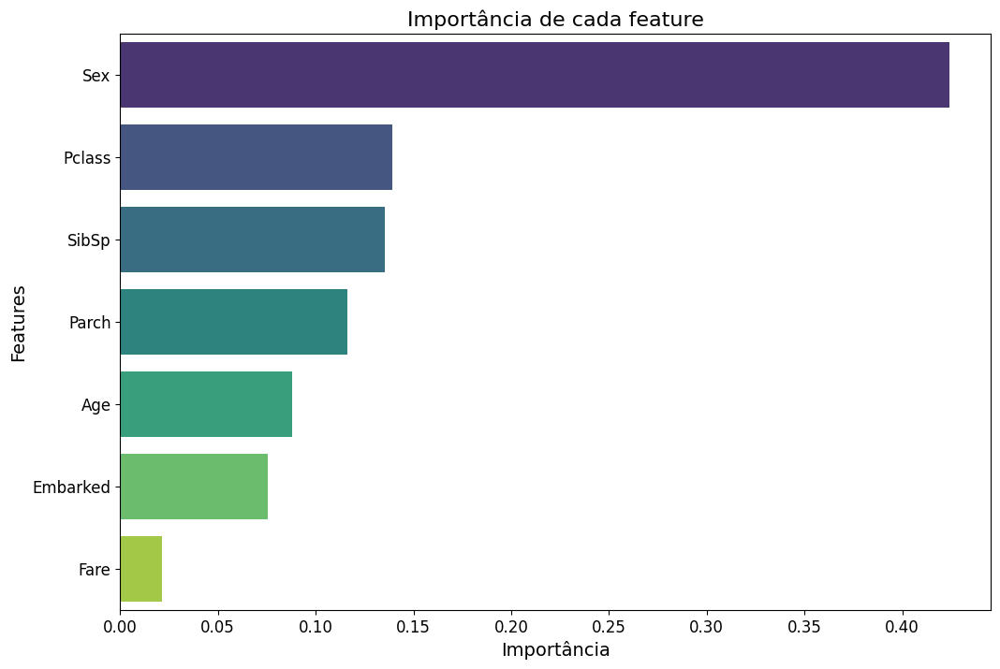

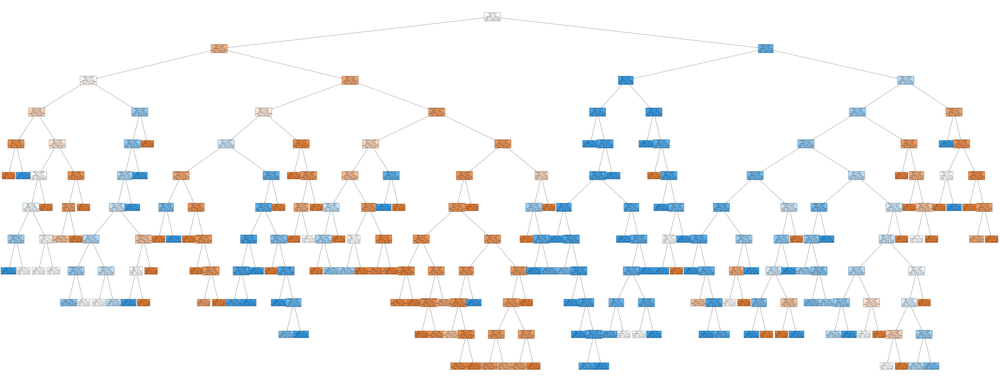


Acurácia do modelo 0.7709090909090909
Classification Report
              precision    recall  f1-score   support

           0       0.73      0.89      0.80       142
           1       0.85      0.64      0.73       133

    accuracy                           0.77       275
   macro avg       0.79      0.77      0.77       275
weighted avg       0.79      0.77      0.77       275

---------------------------------------------------
Gráfico de curva de aprendizado parametros padrões (1 camada):


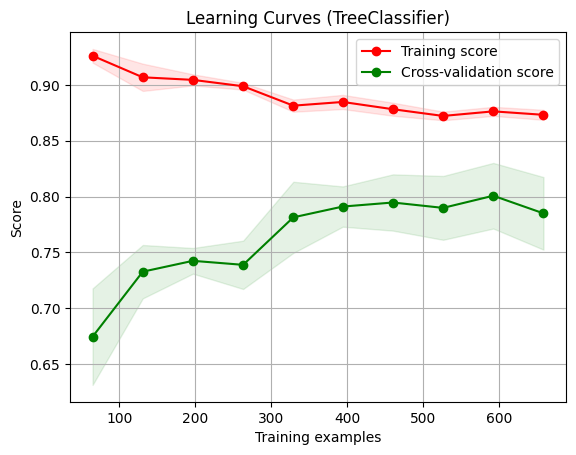

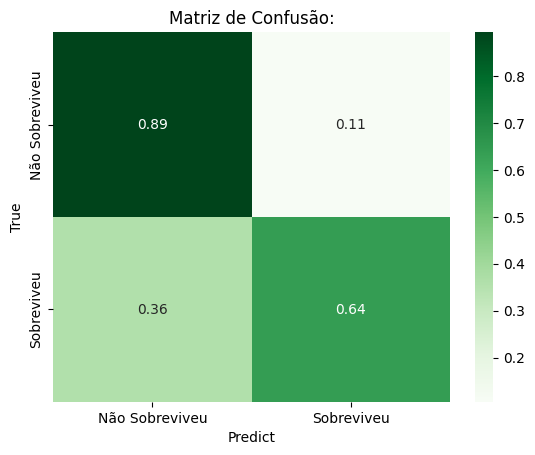

Média da acurácia com Stratified K-Fold Cross-Validation: 77.45% +/- 4.82%
Média da acurácia com K-Fold Cross-Validation: 77.45% +/- 4.08%
------------------- Otimizado -----------------
------------------ Lista de Parametros -----------------
{'ccp_alpha': 1.5533816150343138e-05, 'class_weight': None, 'criterion': 'entropy', 'max_depth': None, 'max_features': 'log2', 'max_leaf_nodes': None, 'min_impurity_decrease': 8.225748332427036e-06, 'min_samples_leaf': 8, 'min_samples_split': 9, 'min_weight_fraction_leaf': 0.009967740960506049, 'random_state': None, 'splitter': 'best'}
------------------ Predição -----------------
Predição dos dados: [1 0 1 1 1 1 0 0 0 1 1 1 1 1 1 1 0 1 1 1 1 0 1 0 0 1 0 1 1 0 0 0 0 1 1 1 0
 0 0 1 1 0 1 0 1 0 0 0 1 1 1 0 0 0 0 0 0 1 1 1 1 1 1 0 1 0 1 1 0 0 0 1 0 1
 1 1 1 1 0 1 0 0 0 1 1 1 0 0 1 0 1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0
 1 0 0 1 1 1 1 1 0 0 1 1 0 0 0 1 0 1 0 0 0 0 1 0 1 0 0 1 1 0 1 1 1 1 0 0 0
 0 0 0 0 1 1 0 0 0 0 0 0 1 0 1 1 1 1 1 1 0 1 1 0 0 1

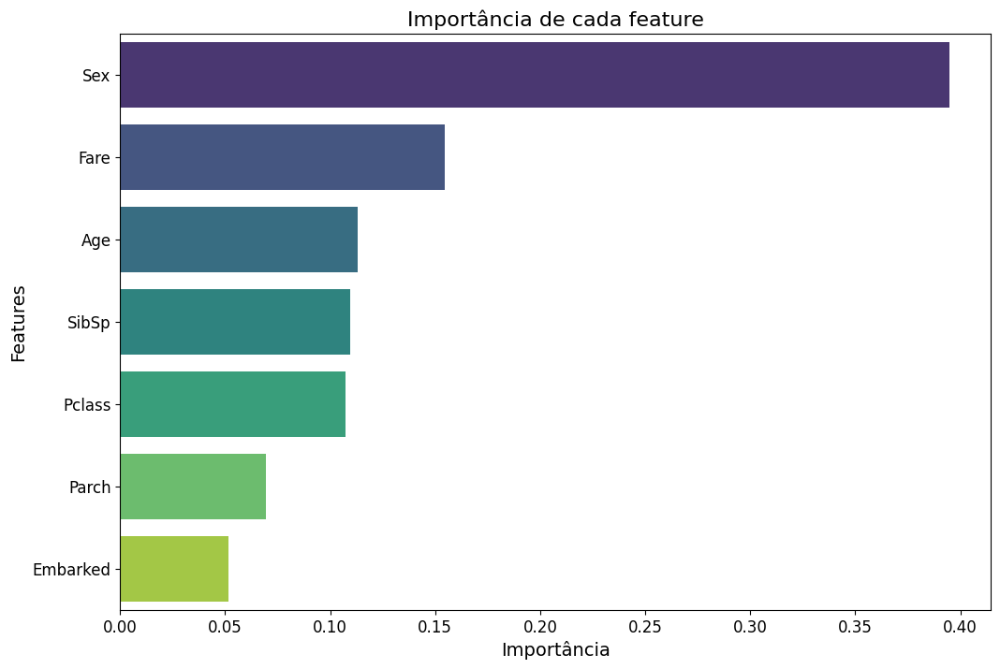

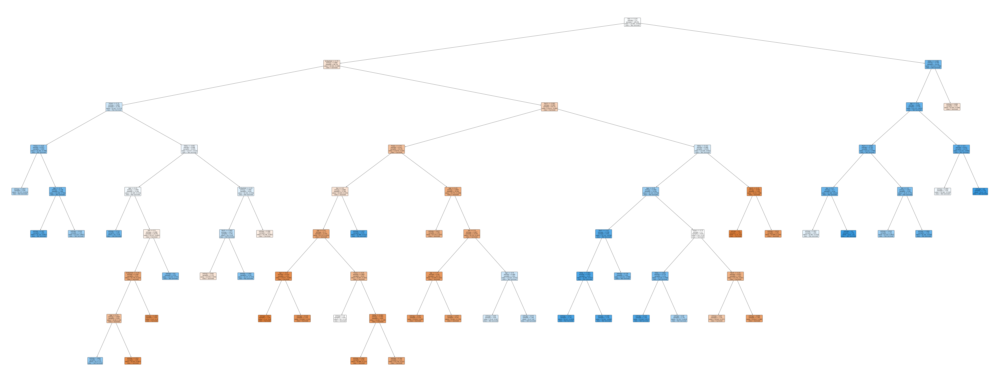


Acurácia do modelo 0.7490909090909091
Classification Report
              precision    recall  f1-score   support

           0       0.77      0.73      0.75       142
           1       0.73      0.77      0.75       133

    accuracy                           0.75       275
   macro avg       0.75      0.75      0.75       275
weighted avg       0.75      0.75      0.75       275

---------------------------------------------------
Gráfico de curva de aprendizado parametros padrões (1 camada):


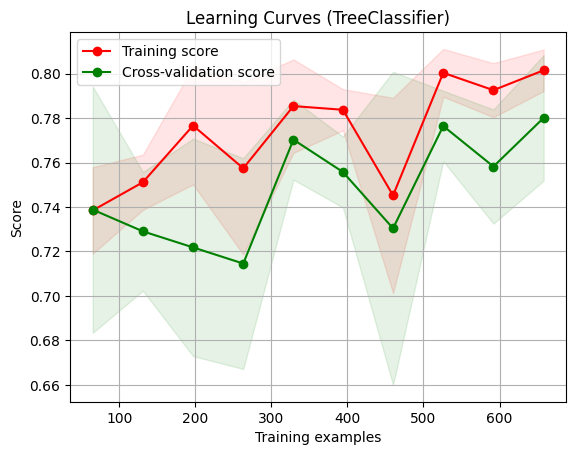

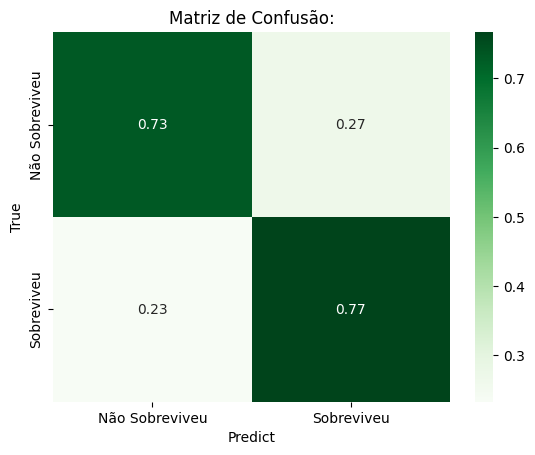

Média da acurácia com Stratified K-Fold Cross-Validation: 74.18% +/- 4.21%
Média da acurácia com K-Fold Cross-Validation: 69.82% +/- 6.15%


array([0.72727273, 0.67272727, 0.61818182, 0.67272727, 0.8       ])

In [ ]:
tree_default = DecisionTreeClassifier(random_state=42)

## parametros sugeridos pela função de hiper parametro Optuna

tree_ = DecisionTreeClassifier(
    min_samples_split=9,
    min_samples_leaf=8,
    max_features='log2',
    criterion='entropy',
    splitter='best',
    min_weight_fraction_leaf=0.009967740960506049,
    min_impurity_decrease=8.225748332427036e-06,
    ccp_alpha=1.5533816150343138e-05
)

print("------------------- Sem Otimização -----------------")


model = treeClassifier(tree_default, X_train, y_train, X_test)
plot_feature_importances(model, X_train)
plot_decision_tree(model, X_train, ['Survived', 'Not Survived'])
infoClassificador(model, y_test, X_test )
accuracy_score_skfold(model, X_test, y_test, 5)
accuracy_score_kfold(model, X_test, y_test, 5)

print("------------------- Otimizado -----------------")

model = treeClassifier(tree_ , X_train, y_train, X_test)
plot_feature_importances(model, X_train)
plot_decision_tree(model, X_train, ['Survived', 'Not Survived'])
infoClassificador(model, y_test, X_test )
accuracy_score_skfold(model, X_test, y_test, 5)
accuracy_score_kfold(model, X_test, y_test, 5)

Com agrupamento normal de Fare

------------------- Sem Otimização -----------------
------------------ Lista de Parametros -----------------
{'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': None, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'random_state': 42, 'splitter': 'best'}
------------------ Predição -----------------
Predição dos dados: [1 1 1 0 0 1 1 0 0 1 0 0 0 1 1 0 0 1 1 0 1 0 0 0 0 1 1 1 0 0 0 1 0 0 1 0 0
 1 1 0 1 0 0 0 1 1 0 0 1 0 1 0 1 1 0 0 0 0 0 1 0 1 0 0 1 0 0 1 0 1 0 1 0 1
 0 1 1 0 0 1 0 1 1 1 0 1 1 0 1 1 0 0 1 0 0 0 1 1 1 0 1 0 1 1 0 0 0 0 1 1 1
 1 0 0 0 0 0 1 0 0 0 1 0 0 0 0 1 0 1 1 0 1 0 0 1 0 0 1 1 1 0 1 1 0 1 1 0 1
 1 1 1 1 0 1 1 0 1 0 1 0 0 1 0 0 0 1 1 1 1 0 1 0 1 1 0 0 1 1 1 0 0 0 0 0 0
 1 0 1 0 0 1 1 0 0 1 0 0 1 0 1 0 0 1 0 1 1 0 0 0 1 0 1 0 1 0 0 1 1 1 1 1 0
 0 0 0 1 1 1 0 1 0 1 0 0 0 0 0 1 1 1 1 1 0 1 1 1 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 0 1 1 1 1 1 1 0 1 1

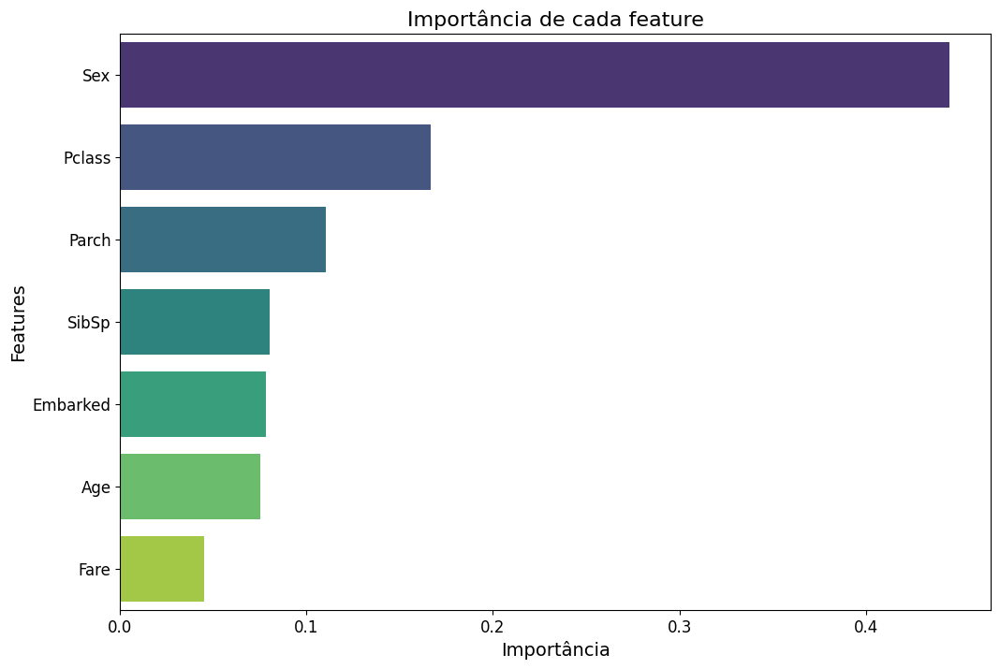

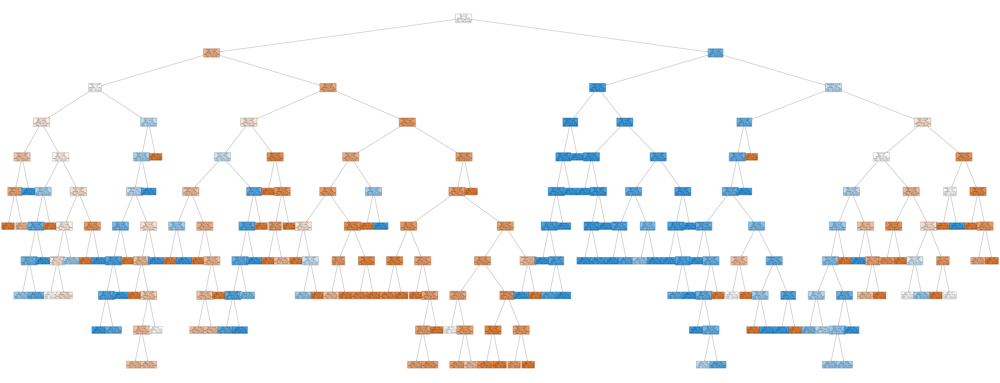


Acurácia do modelo 0.8290909090909091
Classification Report
              precision    recall  f1-score   support

           0       0.81      0.86      0.84       138
           1       0.85      0.80      0.82       137

    accuracy                           0.83       275
   macro avg       0.83      0.83      0.83       275
weighted avg       0.83      0.83      0.83       275

---------------------------------------------------
Gráfico de curva de aprendizado parametros padrões (1 camada):


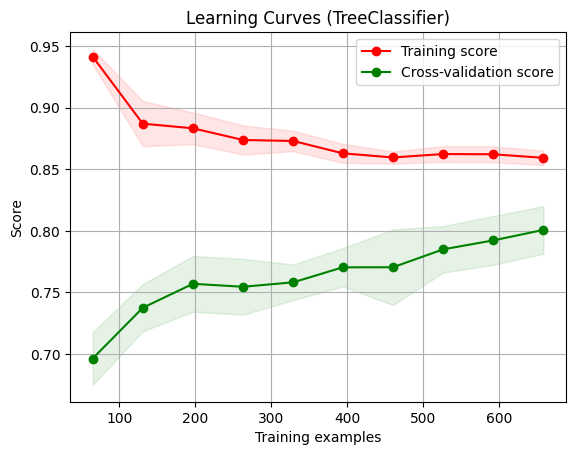

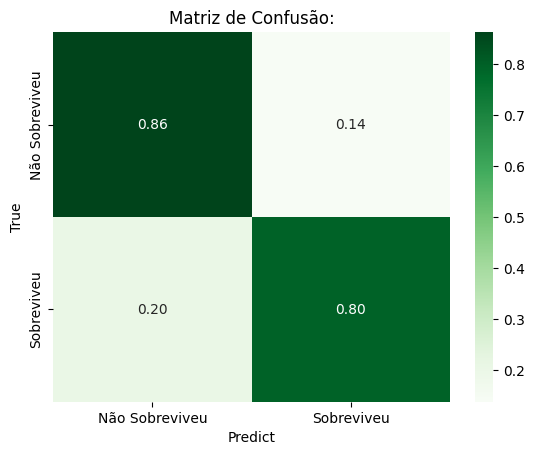

Média da acurácia com Stratified K-Fold Cross-Validation: 77.82% +/- 7.03%
Média da acurácia com K-Fold Cross-Validation: 76.00% +/- 6.65%
------------------- Otimizado -----------------
------------------ Lista de Parametros -----------------
{'ccp_alpha': 1.5533816150343138e-05, 'class_weight': None, 'criterion': 'entropy', 'max_depth': None, 'max_features': 'log2', 'max_leaf_nodes': None, 'min_impurity_decrease': 8.225748332427036e-06, 'min_samples_leaf': 8, 'min_samples_split': 9, 'min_weight_fraction_leaf': 0.009967740960506049, 'random_state': None, 'splitter': 'best'}
------------------ Predição -----------------
Predição dos dados: [1 1 1 0 0 1 1 0 0 1 0 0 0 1 1 0 0 1 1 0 1 0 0 0 0 1 1 1 0 0 0 1 0 1 1 0 0
 1 1 0 1 0 1 0 0 1 0 0 1 0 1 0 1 1 0 0 0 0 0 1 0 1 0 0 1 0 1 1 0 1 0 1 0 1
 0 1 1 0 0 0 0 0 1 1 0 1 1 0 1 1 0 0 1 0 0 0 1 1 1 1 1 1 1 1 0 0 0 0 1 1 0
 1 0 0 0 0 0 1 0 0 0 1 1 0 0 0 1 0 1 1 0 1 0 0 1 0 0 1 1 1 0 1 1 0 1 0 0 1
 1 1 1 1 0 1 1 0 1 0 1 1 1 1 0 1 0 0 1 1 1 0 1 0 1 1

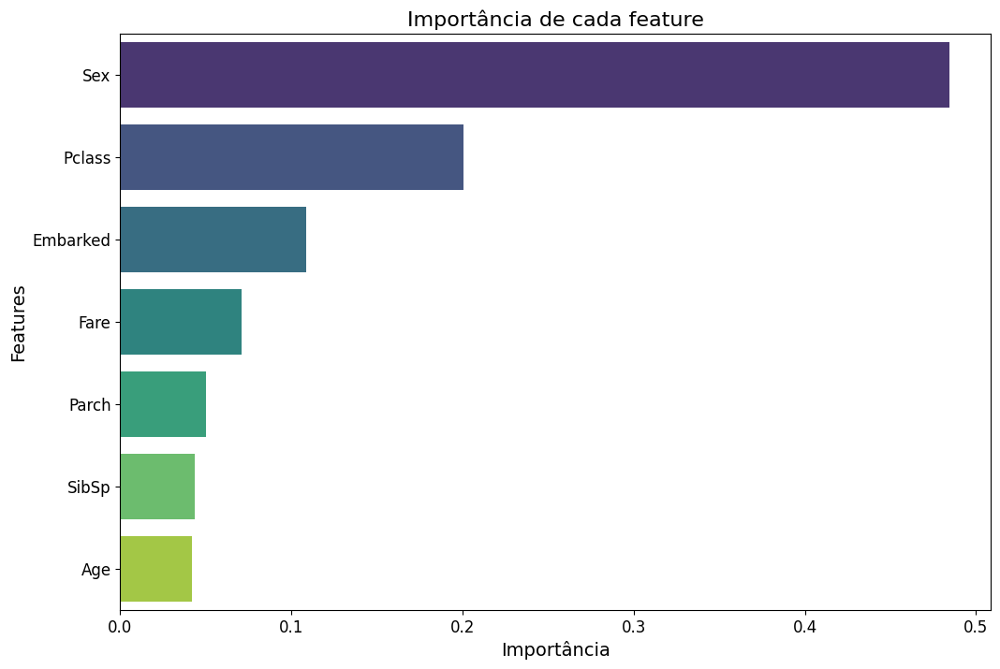

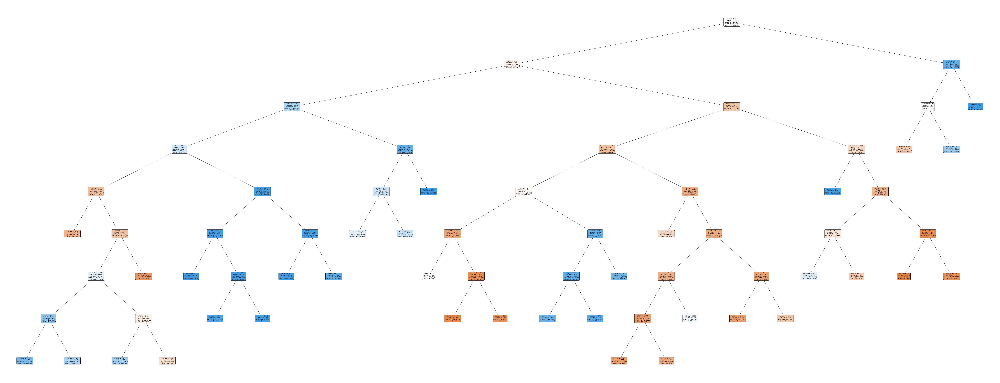


Acurácia do modelo 0.7927272727272727
Classification Report
              precision    recall  f1-score   support

           0       0.79      0.80      0.80       138
           1       0.80      0.78      0.79       137

    accuracy                           0.79       275
   macro avg       0.79      0.79      0.79       275
weighted avg       0.79      0.79      0.79       275

---------------------------------------------------
Gráfico de curva de aprendizado parametros padrões (1 camada):


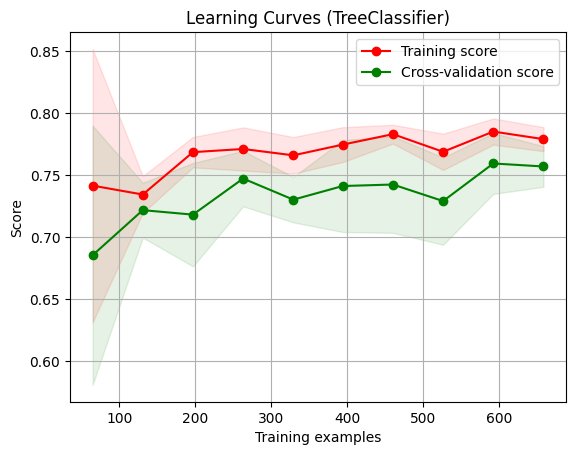

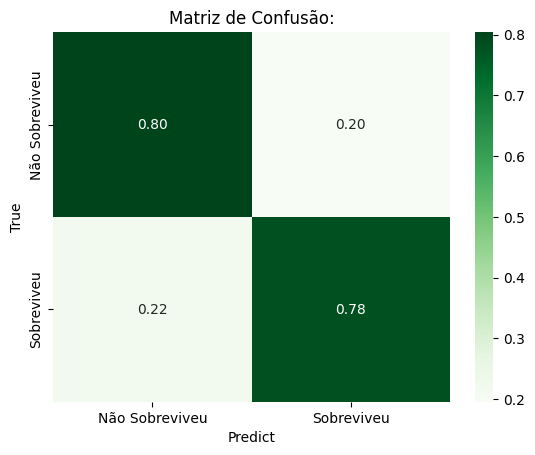

Média da acurácia com Stratified K-Fold Cross-Validation: 72.00% +/- 8.18%
Média da acurácia com K-Fold Cross-Validation: 70.91% +/- 6.90%


array([0.72727273, 0.65454545, 0.81818182, 0.72727273, 0.61818182])

In [ ]:
tree_default = DecisionTreeClassifier(random_state=42)

## parametros sugeridos pela função de hiper parametro Optuna

tree_ = DecisionTreeClassifier(
    min_samples_split=9,
    min_samples_leaf=8,
    max_features='log2',
    criterion='entropy',
    splitter='best',
    min_weight_fraction_leaf=0.009967740960506049,
    min_impurity_decrease=8.225748332427036e-06,
    ccp_alpha=1.5533816150343138e-05
)

print("------------------- Sem Otimização -----------------")


model = treeClassifier(tree_default, X_train, y_train, X_test)
plot_feature_importances(model, X_train)
plot_decision_tree(model, X_train, ['Survived', 'Not Survived'])
infoClassificador(model, y_test, X_test )
accuracy_score_skfold(model, X_test, y_test, 5)
accuracy_score_kfold(model, X_test, y_test, 5)

print("------------------- Otimizado -----------------")

model = treeClassifier(tree_ , X_train, y_train, X_test)
plot_feature_importances(model, X_train)
plot_decision_tree(model, X_train, ['Survived', 'Not Survived'])
infoClassificador(model, y_test, X_test )
accuracy_score_skfold(model, X_test, y_test, 5)
accuracy_score_kfold(model, X_test, y_test, 5)

### Regressão

Agrupamento padrão Fare/ Sem agrupamento Parch

------------------- Sem Otimização -----------------
------------------ Lista de Parametros -----------------
{'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': None, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'random_state': 42, 'splitter': 'best'}
------------------ Predição -----------------
Predição dos dados: [1 1 1 0 0 1 1 0 0 1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 0 1 1 1 0 1 0 1 0 0 1 0 0
 1 1 0 1 0 0 0 1 1 1 0 1 1 1 0 1 1 0 0 0 1 0 0 0 1 0 1 1 0 1 1 0 1 0 1 0 1
 0 1 1 0 0 1 0 1 1 1 1 1 1 0 1 1 0 0 1 0 0 0 1 1 1 0 1 1 1 1 0 0 0 0 1 1 0
 1 0 0 0 0 0 1 0 1 1 0 0 0 1 0 1 0 1 1 0 1 0 0 1 0 0 1 1 1 0 1 1 1 1 1 0 1
 1 1 1 1 0 1 1 0 1 0 1 1 1 1 1 1 0 0 1 1 1 0 1 0 1 1 1 0 1 0 1 1 0 1 0 0 0
 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1 0 1 1 0 1 0 1 1 0 1 0 1 1 1 0 0 1 1 1 1 1 1
 0 0 0 1 1 1 1 1 1 1 0 0 0 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 0 0 0 1 1 0 0 0 0
 0 0 1 1 1 1 1 1 0 1 1

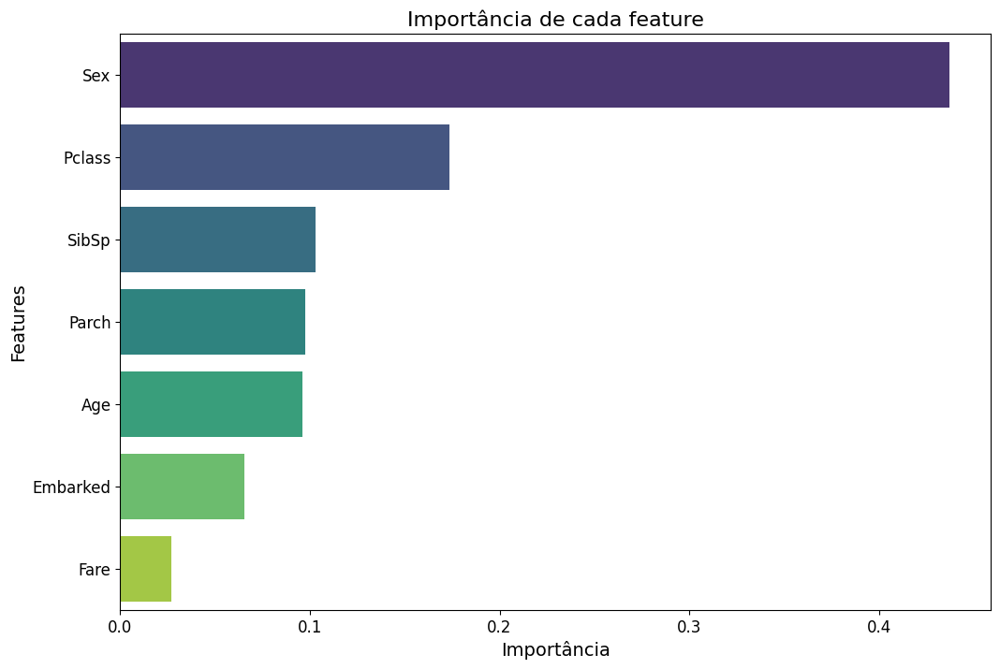

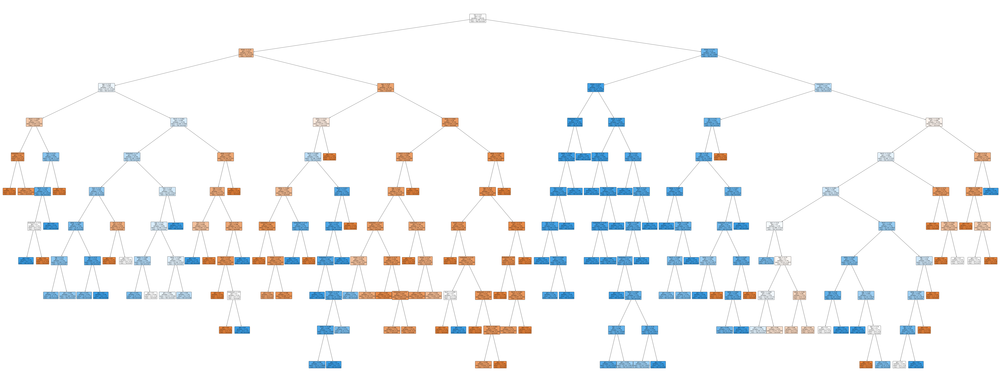


Acurácia do modelo 0.8109090909090909
Classification Report
              precision    recall  f1-score   support

           0       0.84      0.77      0.80       138
           1       0.79      0.85      0.82       137

    accuracy                           0.81       275
   macro avg       0.81      0.81      0.81       275
weighted avg       0.81      0.81      0.81       275

---------------------------------------------------
Gráfico de curva de aprendizado parametros padrões (1 camada):


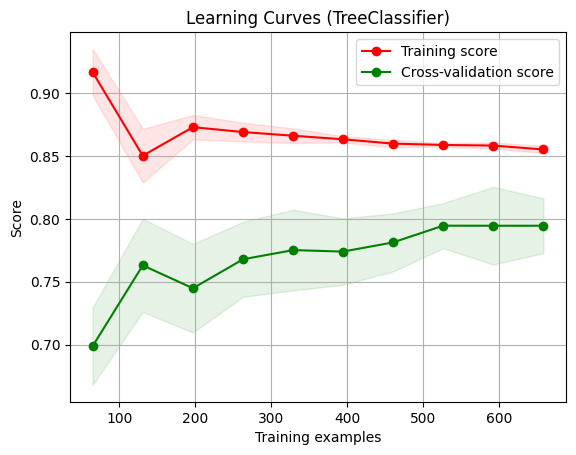

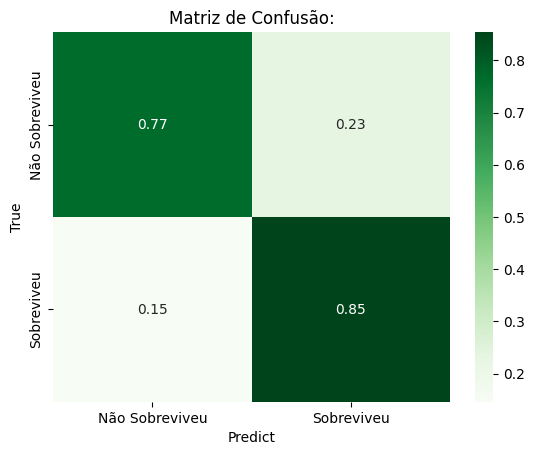

Média da acurácia com Stratified K-Fold Cross-Validation: 77.82% +/- 5.44%
Média da acurácia com K-Fold Cross-Validation: 74.91% +/- 7.03%
------------------- Otimizado -----------------
------------------ Lista de Parametros -----------------
{'ccp_alpha': 1.5533816150343138e-05, 'class_weight': None, 'criterion': 'entropy', 'max_depth': None, 'max_features': 'log2', 'max_leaf_nodes': None, 'min_impurity_decrease': 8.225748332427036e-06, 'min_samples_leaf': 8, 'min_samples_split': 9, 'min_weight_fraction_leaf': 0.009967740960506049, 'random_state': None, 'splitter': 'best'}
------------------ Predição -----------------
Predição dos dados: [1 1 1 0 0 0 1 0 0 1 1 0 0 1 1 0 0 1 0 1 1 0 0 0 0 1 1 1 0 1 0 1 0 0 1 0 0
 1 1 0 1 0 1 0 0 1 1 0 1 1 1 0 1 1 0 0 0 1 0 0 0 0 0 1 1 0 1 1 0 1 0 1 0 1
 0 1 1 0 1 0 0 0 1 1 1 1 1 0 1 1 0 0 1 0 0 0 1 1 1 0 1 1 0 1 0 0 0 0 1 1 0
 1 0 1 0 0 0 1 0 1 1 0 1 0 1 0 1 0 0 1 0 1 0 0 1 0 0 1 1 1 0 1 1 1 1 1 0 1
 0 1 1 1 1 1 1 0 1 0 1 1 1 0 1 0 0 0 1 1 1 0 1 0 1 1

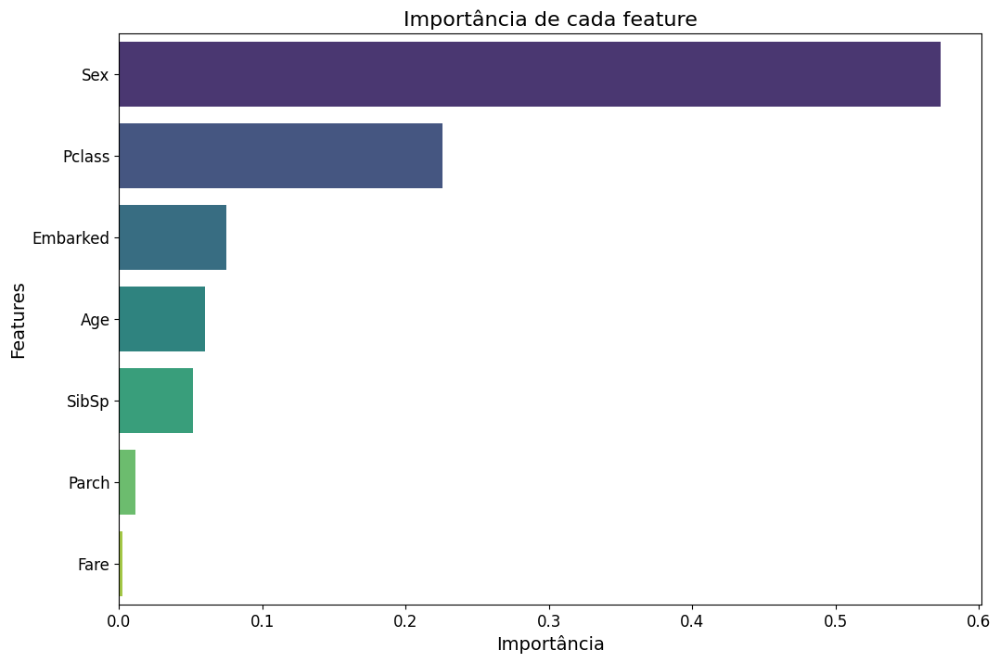

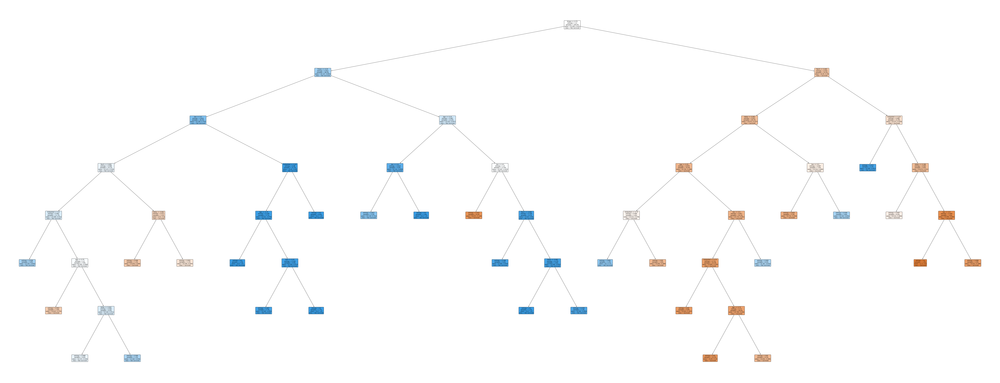


Acurácia do modelo 0.7890909090909091
Classification Report
              precision    recall  f1-score   support

           0       0.81      0.76      0.78       138
           1       0.77      0.82      0.79       137

    accuracy                           0.79       275
   macro avg       0.79      0.79      0.79       275
weighted avg       0.79      0.79      0.79       275

---------------------------------------------------
Gráfico de curva de aprendizado parametros padrões (1 camada):


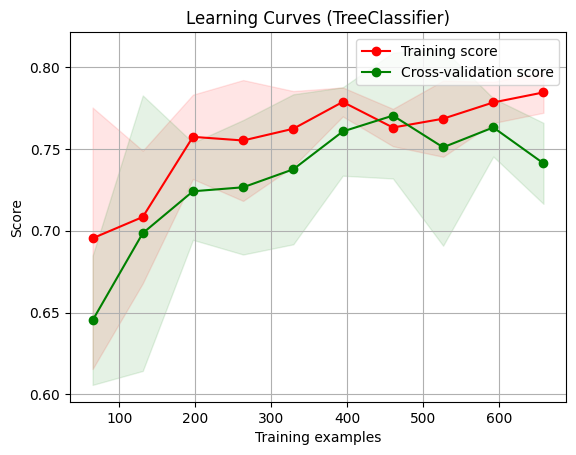

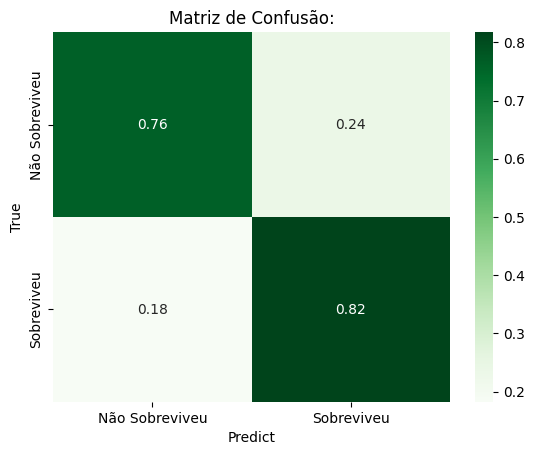

Média da acurácia com Stratified K-Fold Cross-Validation: 78.91% +/- 4.69%
Média da acurácia com K-Fold Cross-Validation: 74.55% +/- 6.99%


array([0.72727273, 0.74545455, 0.63636364, 0.85454545, 0.76363636])

In [ ]:
tree_default = DecisionTreeClassifier(random_state=42)

## parametros sugeridos pela função de hiper parametro Optuna

tree_ = DecisionTreeClassifier(
    min_samples_split=9,
    min_samples_leaf=8,
    max_features='log2',
    criterion='entropy',
    splitter='best',
    min_weight_fraction_leaf=0.009967740960506049,
    min_impurity_decrease=8.225748332427036e-06,
    ccp_alpha=1.5533816150343138e-05
)

print("------------------- Sem Otimização -----------------")


model = treeClassifier(tree_default, X_train, y_train, X_test)
plot_feature_importances(model, X_train)
plot_decision_tree(model, X_train, ['Survived', 'Not Survived'])
infoClassificador(model, y_test, X_test )
accuracy_score_skfold(model, X_test, y_test, 5)
accuracy_score_kfold(model, X_test, y_test, 5)

print("------------------- Otimizado -----------------")

model = treeClassifier(tree_ , X_train, y_train, X_test)
plot_feature_importances(model, X_train)
plot_decision_tree(model, X_train, ['Survived', 'Not Survived'])
infoClassificador(model, y_test, X_test )
accuracy_score_skfold(model, X_test, y_test, 5)
accuracy_score_kfold(model, X_test, y_test, 5)

Com agrupamento normal e Parch

------------------- Sem Otimização -----------------
------------------ Lista de Parametros -----------------
{'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': None, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'random_state': 42, 'splitter': 'best'}
------------------ Predição -----------------
Predição dos dados: [1 1 1 1 1 1 0 0 0 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 1 0 1 1 0 0 0 0 1 1 1 0
 0 0 0 1 0 1 0 1 0 0 0 1 1 0 0 0 1 1 0 0 0 1 1 0 0 1 0 1 0 1 1 0 0 1 1 0 1
 0 1 0 1 0 1 0 0 0 1 1 0 0 0 1 0 1 0 1 0 0 0 1 1 1 0 0 0 1 1 1 0 0 0 1 0 0
 1 0 0 1 0 1 0 1 0 1 1 0 0 0 0 1 0 1 0 0 0 0 0 0 1 0 0 0 0 0 1 1 1 0 1 0 0
 0 1 0 0 1 1 0 0 1 0 0 1 0 0 0 0 1 1 1 1 0 0 1 0 0 1 1 0 1 1 1 0 0 1 0 0 0
 1 0 1 1 0 1 1 0 1 1 0 0 1 1 1 0 0 1 1 0 1 1 0 1 0 1 0 1 1 1 1 0 1 1 1 1 0
 1 0 1 0 1 0 1 1 0 0 0 0 1 0 0 1 1 1 1 0 0 1 1 0 1 0 0 1 0 1 0 1 1 0 0 1 1
 0 0 1 1 0 1 0 0 1 0 1

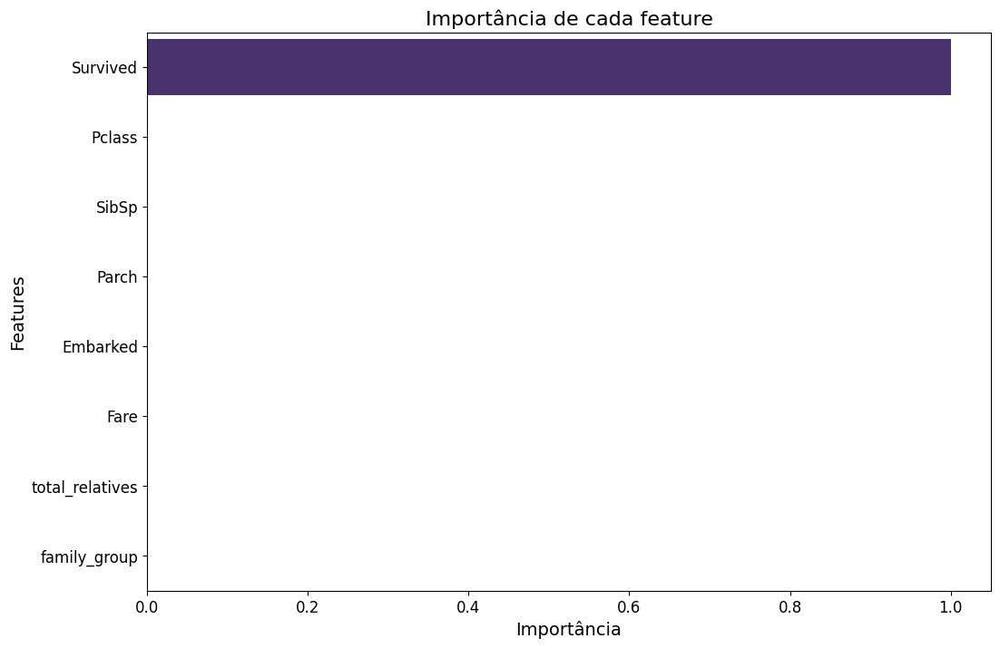

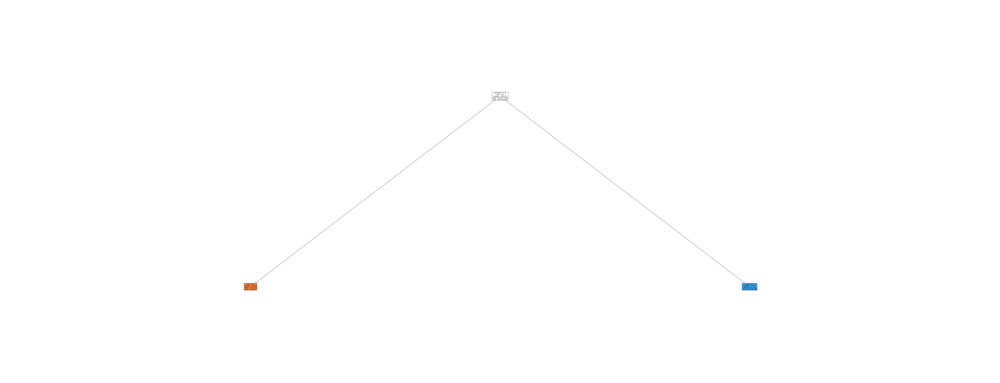


Acurácia do modelo 1.0
Classification Report
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       142
           1       1.00      1.00      1.00       133

    accuracy                           1.00       275
   macro avg       1.00      1.00      1.00       275
weighted avg       1.00      1.00      1.00       275

---------------------------------------------------
Gráfico de curva de aprendizado parametros padrões (1 camada):


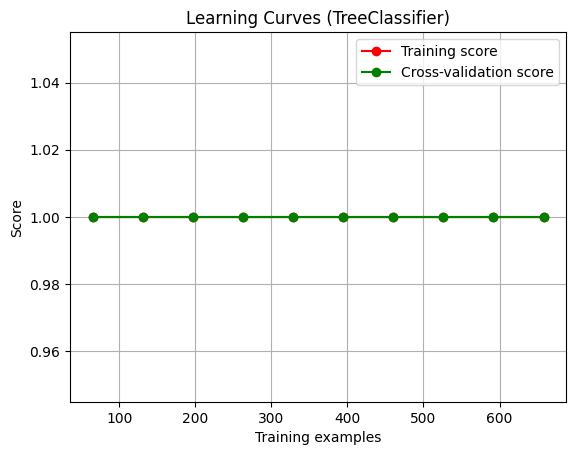

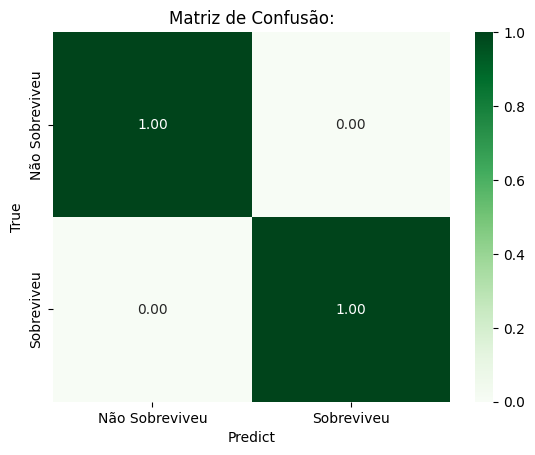

Média da acurácia com Stratified K-Fold Cross-Validation: 100.00% +/- 0.00%
Média da acurácia com K-Fold Cross-Validation: 100.00% +/- 0.00%
------------------- Otimizado -----------------
------------------ Lista de Parametros -----------------
{'ccp_alpha': 1.5533816150343138e-05, 'class_weight': None, 'criterion': 'entropy', 'max_depth': None, 'max_features': 'log2', 'max_leaf_nodes': None, 'min_impurity_decrease': 8.225748332427036e-06, 'min_samples_leaf': 8, 'min_samples_split': 9, 'min_weight_fraction_leaf': 0.009967740960506049, 'random_state': None, 'splitter': 'best'}
------------------ Predição -----------------
Predição dos dados: [1 1 1 1 1 1 0 0 0 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 1 0 1 1 0 0 0 0 1 1 1 0
 0 0 0 1 0 1 0 1 0 0 0 1 1 0 0 0 1 1 0 0 0 1 1 0 0 1 0 1 0 1 1 0 0 1 1 0 1
 0 1 0 1 0 1 0 0 0 1 1 0 0 0 1 0 1 0 1 0 0 0 1 1 1 0 0 0 1 1 1 0 0 0 1 0 0
 1 0 0 1 0 1 0 1 0 1 1 0 0 0 0 1 0 1 0 0 0 0 0 0 1 0 0 0 0 0 1 1 1 0 1 0 0
 0 1 0 0 1 1 0 0 1 0 0 1 0 0 0 0 1 1 1 1 0 0 1 0 0

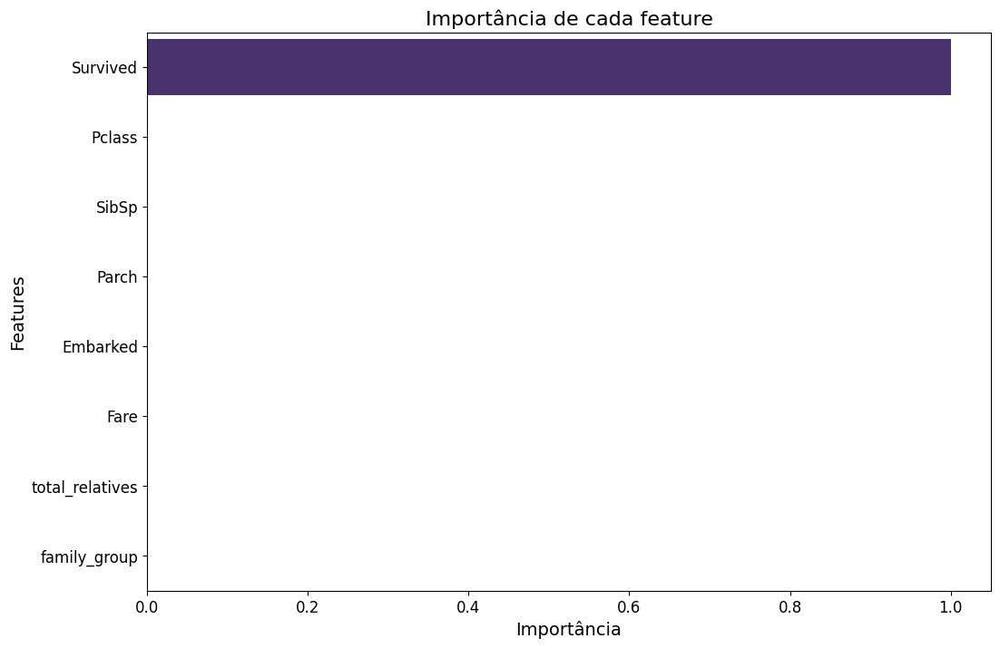

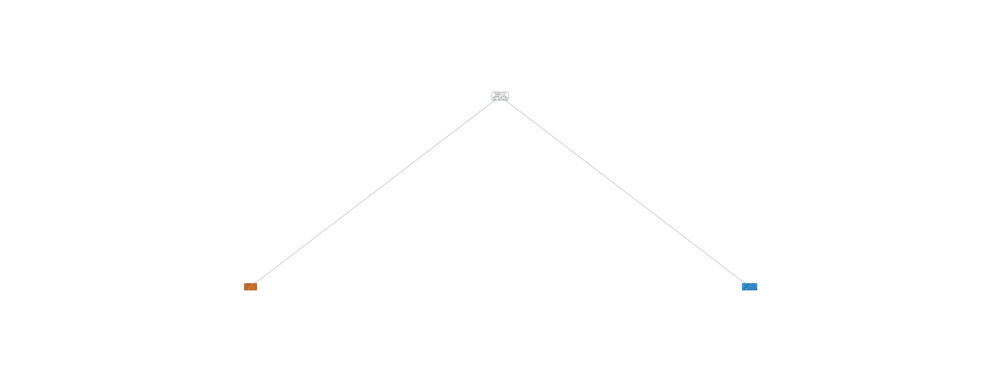


Acurácia do modelo 1.0
Classification Report
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       142
           1       1.00      1.00      1.00       133

    accuracy                           1.00       275
   macro avg       1.00      1.00      1.00       275
weighted avg       1.00      1.00      1.00       275

---------------------------------------------------
Gráfico de curva de aprendizado parametros padrões (1 camada):


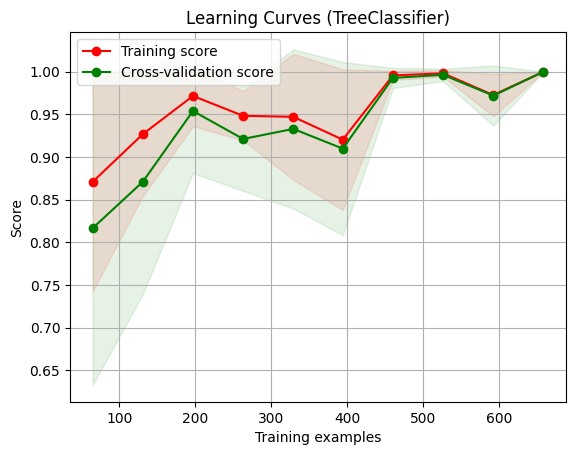

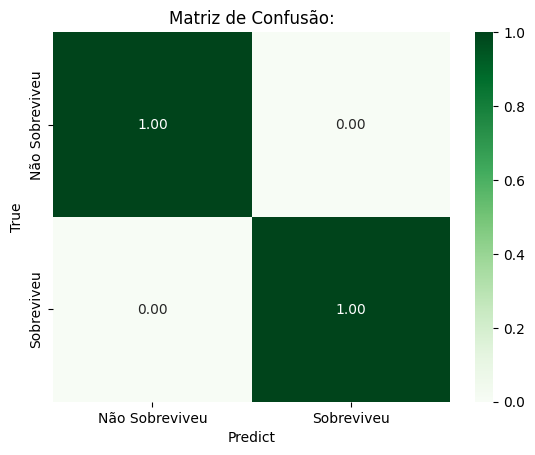

Média da acurácia com Stratified K-Fold Cross-Validation: 98.18% +/- 3.64%
Média da acurácia com K-Fold Cross-Validation: 97.45% +/- 5.09%


array([1.        , 0.87272727, 1.        , 1.        , 1.        ])

In [ ]:
tree_default = DecisionTreeClassifier(random_state=42)

## parametros sugeridos pela função de hiper parametro Optuna

tree_ = DecisionTreeClassifier(
    min_samples_split=9,
    min_samples_leaf=8,
    max_features='log2',
    criterion='entropy',
    splitter='best',
    min_weight_fraction_leaf=0.009967740960506049,
    min_impurity_decrease=8.225748332427036e-06,
    ccp_alpha=1.5533816150343138e-05
)

print("------------------- Sem Otimização -----------------")


model = treeClassifier(tree_default, X_train, y_train, X_test)
plot_feature_importances(model, X_train)
plot_decision_tree(model, X_train, ['Survived', 'Not Survived'])
infoClassificador(model, y_test, X_test )
accuracy_score_skfold(model, X_test, y_test, 5)
accuracy_score_kfold(model, X_test, y_test, 5)

print("------------------- Otimizado -----------------")

model = treeClassifier(tree_ , X_train, y_train, X_test)
plot_feature_importances(model, X_train)
plot_decision_tree(model, X_train, ['Survived', 'Not Survived'])
infoClassificador(model, y_test, X_test )
accuracy_score_skfold(model, X_test, y_test, 5)
accuracy_score_kfold(model, X_test, y_test, 5)

###  KNN

Sem agrupamento Fare

------------------- Sem Otimização -----------------
------------------ Lista de Parametros -----------------
{'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': None, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'random_state': 42, 'splitter': 'best'}
------------------ Predição -----------------
Predição dos dados: [1 1 1 0 0 0 1 0 0 1 1 0 0 1 1 0 0 1 1 1 1 0 0 0 0 1 1 1 0 1 0 1 0 0 1 0 0
 1 1 0 1 0 1 0 1 1 1 0 1 1 1 0 1 1 0 0 0 1 0 1 0 0 0 1 1 0 1 1 0 1 0 1 0 1
 0 1 1 0 1 1 0 1 1 1 1 1 1 0 1 1 0 0 1 0 0 0 1 1 1 0 1 1 1 1 0 0 0 0 1 0 1
 1 0 0 0 0 0 1 0 1 1 1 1 0 1 0 1 0 1 1 0 1 0 0 1 0 0 1 1 1 0 1 1 1 1 1 0 1
 1 1 1 1 0 1 1 0 1 0 1 1 1 1 1 1 0 1 1 1 1 0 1 0 1 1 1 0 1 0 1 1 0 1 0 0 0
 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1 0 1 1 0 1 1 1 1 0 1 0 1 1 1 0 0 1 1 1 1 1 1
 0 0 0 1 1 1 1 1 1 1 0 0 0 0 0 0 1 1 1 0 0 1 1 1 0 0 0 1 0 0 0 1 1 0 0 0 0
 0 0 1 1 1 1 1 1 1 1 1

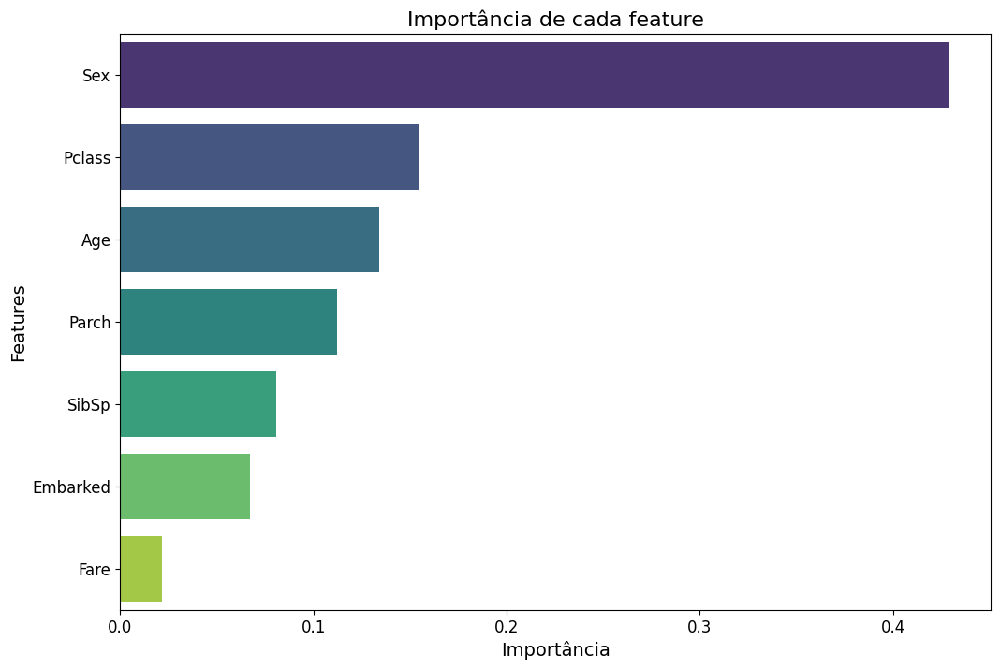

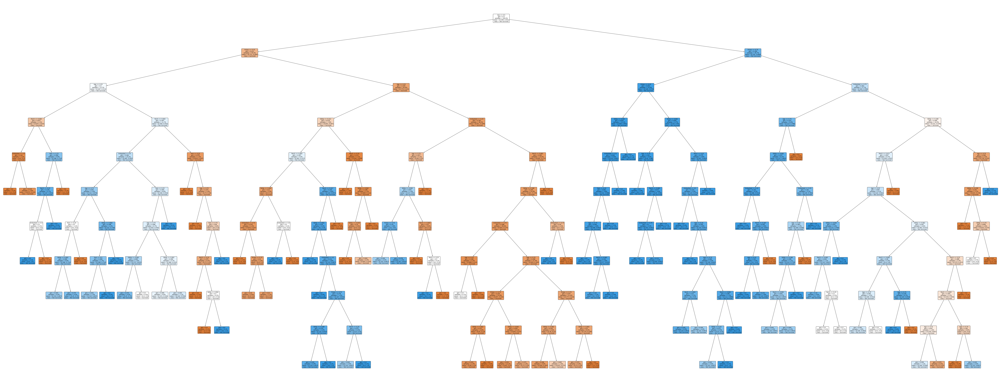


Acurácia do modelo 0.8218181818181818
Classification Report
              precision    recall  f1-score   support

           0       0.88      0.75      0.81       138
           1       0.78      0.90      0.83       137

    accuracy                           0.82       275
   macro avg       0.83      0.82      0.82       275
weighted avg       0.83      0.82      0.82       275

---------------------------------------------------
Gráfico de curva de aprendizado parametros padrões (1 camada):


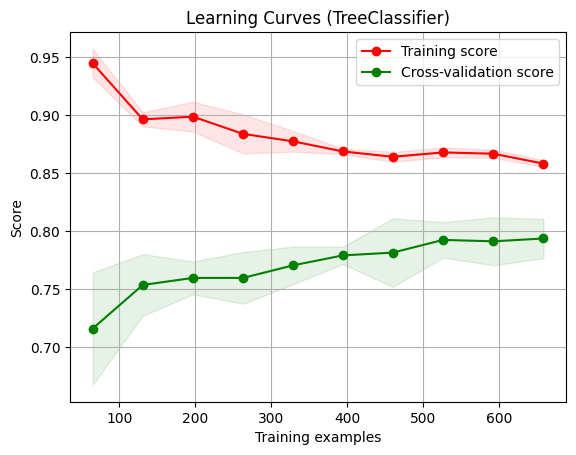

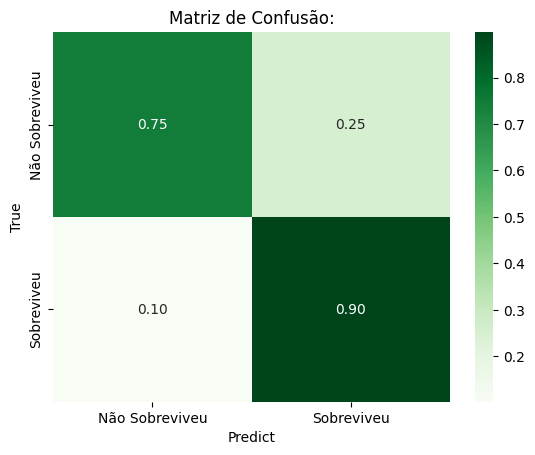

Média da acurácia com Stratified K-Fold Cross-Validation: 76.36% +/- 5.63%
Média da acurácia com K-Fold Cross-Validation: 73.45% +/- 6.04%
------------------- Otimizado -----------------
------------------ Lista de Parametros -----------------
{'ccp_alpha': 1.5533816150343138e-05, 'class_weight': None, 'criterion': 'entropy', 'max_depth': None, 'max_features': 'log2', 'max_leaf_nodes': None, 'min_impurity_decrease': 8.225748332427036e-06, 'min_samples_leaf': 8, 'min_samples_split': 9, 'min_weight_fraction_leaf': 0.009967740960506049, 'random_state': None, 'splitter': 'best'}
------------------ Predição -----------------
Predição dos dados: [1 1 1 0 0 1 1 0 0 1 1 0 0 1 1 0 0 1 1 1 1 0 0 0 0 1 1 1 0 1 0 1 0 0 1 0 0
 1 1 0 1 0 1 0 0 1 1 0 1 1 1 0 0 1 0 0 0 1 0 1 0 1 0 1 1 0 1 1 0 1 0 1 0 1
 0 1 1 0 0 0 1 0 1 1 0 1 1 0 1 1 0 0 1 0 0 0 1 1 1 1 1 1 1 1 1 0 0 0 1 0 1
 1 0 0 0 0 0 1 0 0 1 1 1 0 1 0 1 0 0 1 0 1 0 0 1 0 0 1 1 1 0 1 1 0 1 1 0 1
 1 1 1 1 0 0 1 0 1 0 1 1 1 0 0 0 0 1 1 1 1 0 1 0 1 0

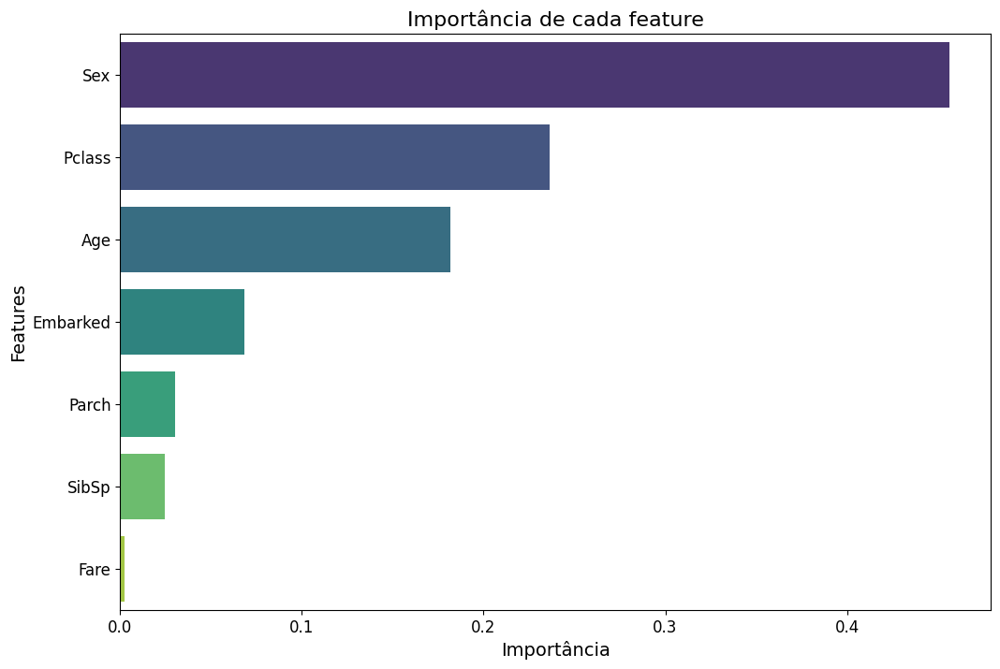

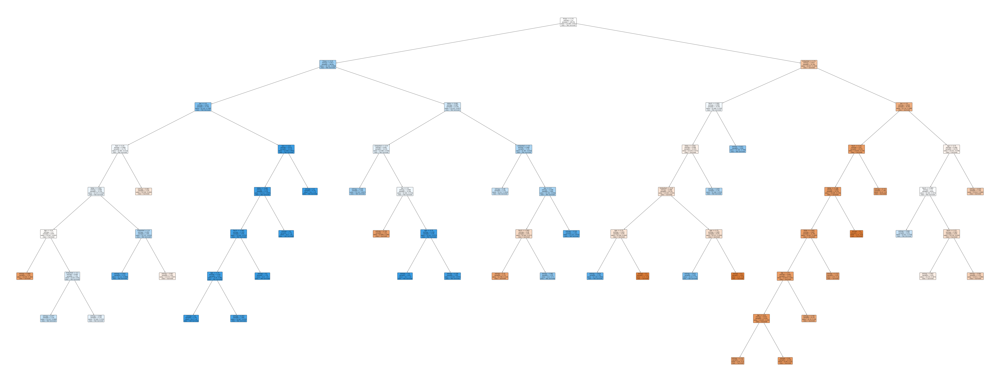


Acurácia do modelo 0.7745454545454545
Classification Report
              precision    recall  f1-score   support

           0       0.81      0.72      0.76       138
           1       0.75      0.83      0.79       137

    accuracy                           0.77       275
   macro avg       0.78      0.77      0.77       275
weighted avg       0.78      0.77      0.77       275

---------------------------------------------------
Gráfico de curva de aprendizado parametros padrões (1 camada):


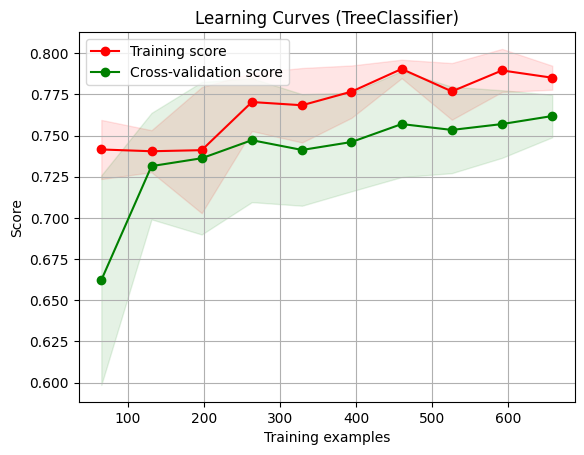

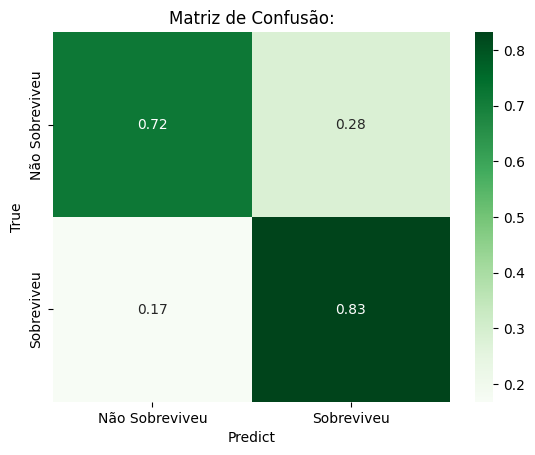

Média da acurácia com Stratified K-Fold Cross-Validation: 77.09% +/- 4.69%
Média da acurácia com K-Fold Cross-Validation: 78.91% +/- 4.69%


array([0.70909091, 0.78181818, 0.83636364, 0.78181818, 0.83636364])

In [ ]:
tree_default = DecisionTreeClassifier(random_state=42)

## parametros sugeridos pela função de hiper parametro Optuna

tree_ = DecisionTreeClassifier(
    min_samples_split=9,
    min_samples_leaf=8,
    max_features='log2',
    criterion='entropy',
    splitter='best',
    min_weight_fraction_leaf=0.009967740960506049,
    min_impurity_decrease=8.225748332427036e-06,
    ccp_alpha=1.5533816150343138e-05
)

print("------------------- Sem Otimização -----------------")


model = treeClassifier(tree_default, X_train, y_train, X_test)
plot_feature_importances(model, X_train)
plot_decision_tree(model, X_train, ['Survived', 'Not Survived'])
infoClassificador(model, y_test, X_test )
accuracy_score_skfold(model, X_test, y_test, 5)
accuracy_score_kfold(model, X_test, y_test, 5)

print("------------------- Otimizado -----------------")

model = treeClassifier(tree_ , X_train, y_train, X_test)
plot_feature_importances(model, X_train)
plot_decision_tree(model, X_train, ['Survived', 'Not Survived'])
infoClassificador(model, y_test, X_test )
accuracy_score_skfold(model, X_test, y_test, 5)
accuracy_score_kfold(model, X_test, y_test, 5)

Com agrupamento Fare

------------------- Sem Otimização -----------------
------------------ Lista de Parametros -----------------
{'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': None, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'random_state': 42, 'splitter': 'best'}
------------------ Predição -----------------
Predição dos dados: [1 0 1 1 1 0 0 0 0 1 0 1 1 0 1 1 0 1 1 1 1 0 1 0 0 1 0 0 1 0 0 0 0 0 0 1 0
 0 0 1 1 0 0 0 1 0 0 1 1 1 1 0 0 1 0 0 0 0 1 1 0 0 1 0 1 0 1 1 0 0 1 1 0 1
 1 0 0 1 0 1 0 0 0 1 1 1 0 0 1 0 1 0 1 0 0 0 0 0 1 0 0 0 1 1 1 0 0 0 1 0 0
 1 0 0 1 0 1 0 1 0 1 1 0 0 0 0 0 0 1 0 0 0 0 1 1 1 0 0 1 1 0 1 1 0 0 1 0 0
 0 0 0 0 0 1 0 0 1 0 0 0 1 0 1 0 1 1 1 1 0 0 1 0 0 1 1 0 1 1 1 1 0 1 0 0 1
 1 0 1 0 0 1 1 0 1 1 0 0 0 0 0 0 0 1 1 0 1 0 0 1 0 0 0 1 1 1 1 0 1 1 1 1 0
 0 0 1 0 0 0 1 1 0 0 0 0 0 0 0 1 1 0 1 0 0 1 1 0 1 0 0 1 1 0 0 0 0 0 0 1 0
 0 0 0 1 0 1 1 0 0 1 1

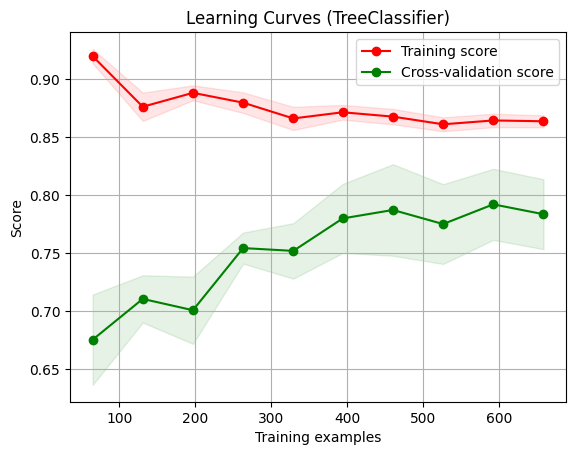

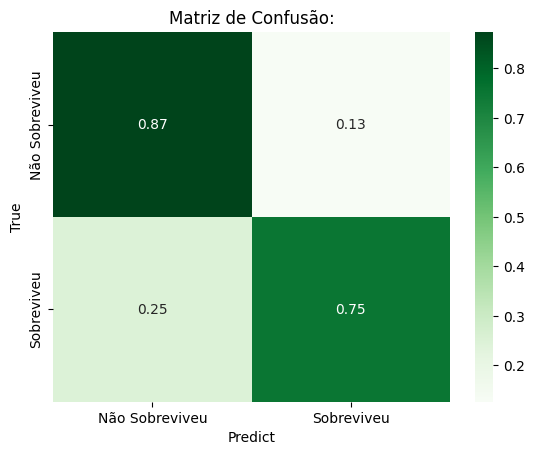

Média da acurácia com Stratified K-Fold Cross-Validation: 80.00% +/- 4.74%
Média da acurácia com K-Fold Cross-Validation: 77.82% +/- 3.53%
------------------- Otimizado -----------------
------------------ Lista de Parametros -----------------
{'ccp_alpha': 0.007809864087944642, 'class_weight': None, 'criterion': 'log_loss', 'max_depth': None, 'max_features': 'log2', 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0035918609702539194, 'min_samples_leaf': 10, 'min_samples_split': 3, 'min_weight_fraction_leaf': 0.01000064075266455, 'random_state': 42, 'splitter': 'best'}
------------------ Predição -----------------
Predição dos dados: [1 0 1 1 1 1 0 0 0 1 1 1 1 1 1 1 0 1 1 1 1 0 1 0 0 1 1 0 1 0 0 0 0 1 0 1 1
 0 0 1 1 0 1 0 1 0 0 0 1 1 1 0 0 1 0 0 0 1 1 1 1 1 1 1 1 0 1 0 1 0 0 1 0 1
 1 0 1 1 0 0 1 0 0 1 1 1 0 1 1 0 1 1 0 1 0 0 0 1 1 0 0 1 0 1 1 1 1 0 1 1 0
 0 0 0 1 1 1 1 1 0 1 1 1 0 1 0 1 0 1 0 0 0 0 1 1 1 0 0 1 1 0 1 1 1 1 1 0 0
 0 1 0 1 1 1 0 0 0 1 0 1 1 0 1 1 1 1 1 1 0 1 1 0 0 1 1 

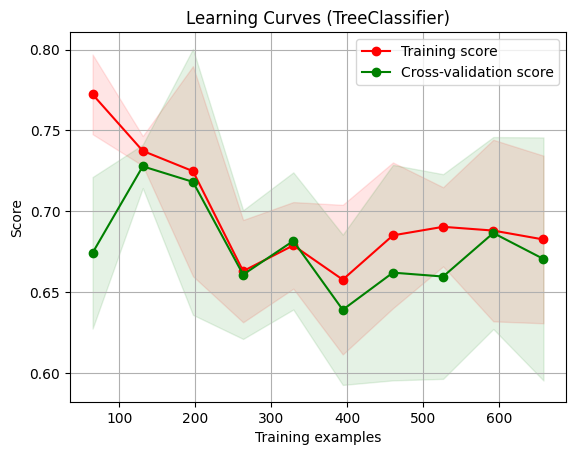

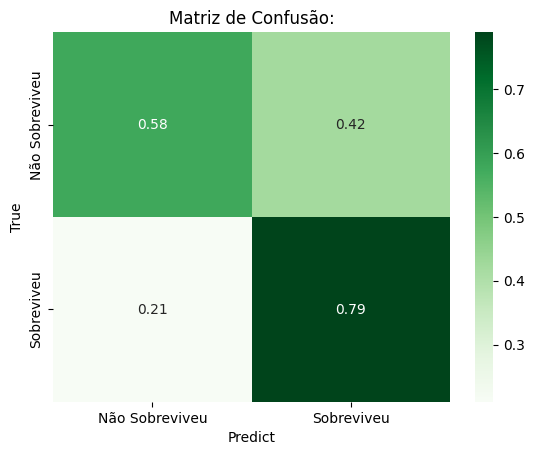

Média da acurácia com Stratified K-Fold Cross-Validation: 78.91% +/- 1.85%
Média da acurácia com K-Fold Cross-Validation: 78.91% +/- 5.93%


array([0.74545455, 0.78181818, 0.83636364, 0.70909091, 0.87272727])

In [ ]:
tree_default = DecisionTreeClassifier(random_state=42)

## parametros sugeridos pela função de hiper parametro Optuna

tree_ = DecisionTreeClassifier(
    min_samples_split=9,
    min_samples_leaf=8,
    max_features='log2',
    criterion='entropy',
    splitter='best',
    min_weight_fraction_leaf=0.009967740960506049,
    min_impurity_decrease=8.225748332427036e-06,
    ccp_alpha=1.5533816150343138e-05
)

print("------------------- Sem Otimização -----------------")


model = treeClassifier(tree_default, X_train, y_train, X_test)
plot_feature_importances(model, X_train)
plot_decision_tree(model, X_train, ['Survived', 'Not Survived'])
infoClassificador(model, y_test, X_test )
accuracy_score_skfold(model, X_test, y_test, 5)
accuracy_score_kfold(model, X_test, y_test, 5)

print("------------------- Otimizado -----------------")

model = treeClassifier(tree_ , X_train, y_train, X_test)
plot_feature_importances(model, X_train)
plot_decision_tree(model, X_train, ['Survived', 'Not Survived'])
infoClassificador(model, y_test, X_test )
accuracy_score_skfold(model, X_test, y_test, 5)
accuracy_score_kfold(model, X_test, y_test, 5)

# Random Forest

Random Forest é um algoritmo que combina múltiplas árvores de decisão para melhorar a precisão e a robustez da previsão. Cada árvore na floresta é construída usando um subconjunto aleatório de amostras do conjunto de dados original e um subconjunto aleatório de características para cada divisão. Essa randomização ajuda a reduzir o overfitting, uma vez que as árvores individuais se tornam menos correlacionadas entre si. No processo de previsão, cada árvore na floresta fornece uma previsão, e a Random Forest combina essas previsões por meio de votação.

Fizemos experimentos utilizando duas Random Forests. Uma com os parametros padrões da função RandomForestClassifier() e a outra utilizando os parametros encontrados no tunning de hiperparametros.

## Random Forest com parâmetros padrões

Alguns dos parâmetros default que configuram o comportamento do Random Forest são:
**n_estimators=100** -> ele cria 100 árvores na floresta

**criterion='gini'** -> e utiliza o critério de impureza Gini para dividir os nós

**max_depth=None** -> A profundidade máxima das árvores não é limitada

**min_samples_split=2** -> o número mínimo de amostras necessárias para dividir um nó interno é 2

**min_samples_leaf=1** -> enquanto o número mínimo de amostras em um nó folha é 1

In [ ]:
def randomForestPadrao(X_train, y_train):
  #Criando modelo
  model = RandomForestClassifier()

  #Medindo a acurácia com SK-Fold
  acuracy_skfold = accuracy_score_skfold(model, X_train, y_train, 5)

  return model

### Classificar

Média da acurácia com Stratified K-Fold Cross-Validation: 80.92% +/- 1.12%


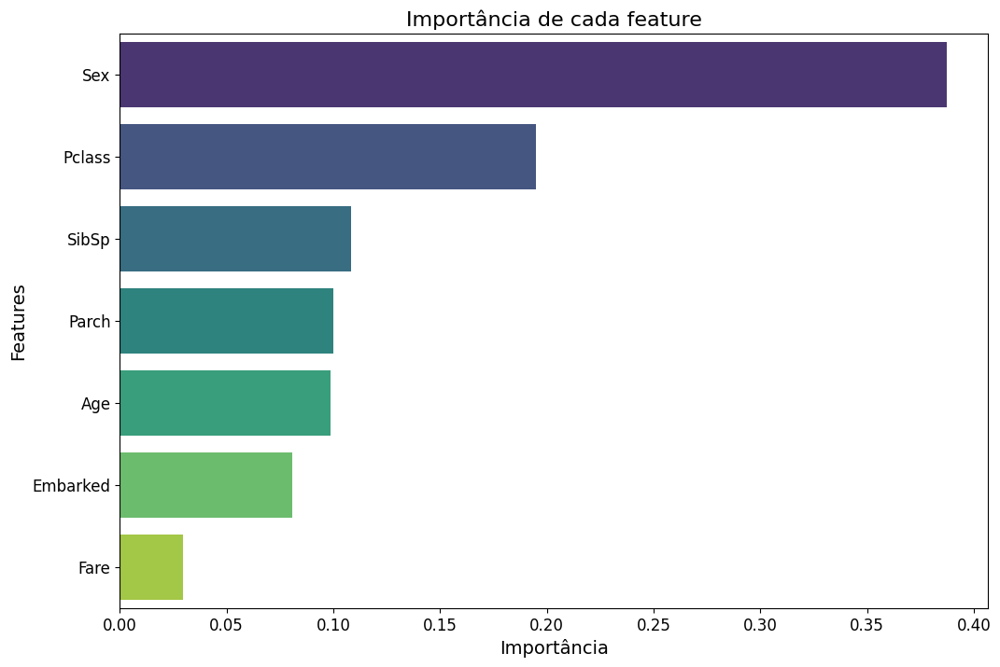


Acurácia do modelo 0.7963636363636364
Classification Report
              precision    recall  f1-score   support

           0       0.81      0.78      0.79       138
           1       0.79      0.81      0.80       137

    accuracy                           0.80       275
   macro avg       0.80      0.80      0.80       275
weighted avg       0.80      0.80      0.80       275

---------------------------------------------------
Gráfico de curva de aprendizado parametros padrões (1 camada):


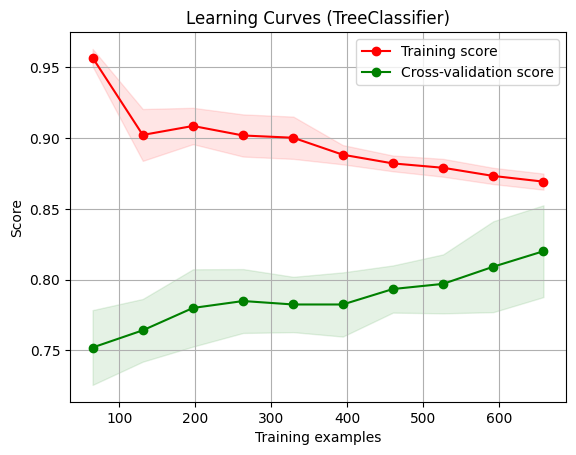

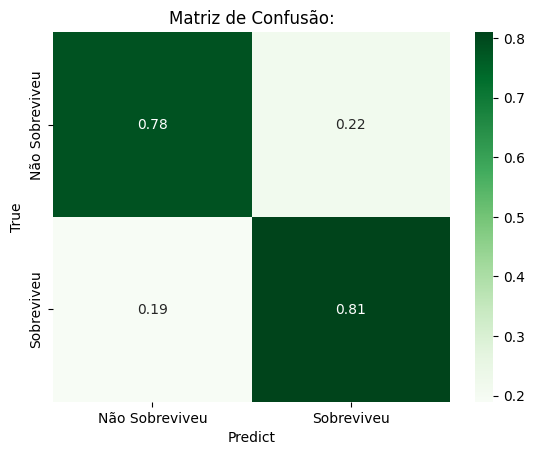

In [ ]:
rfp_model = randomForestPadrao(X_train, y_train)
rfp_model.fit(X_train, y_train)
plot_feature_importances(rfp_model, X_train)
infoClassificador(rfp_model, y_test, X_test)

## Random Forest com parâmetros do RandomSearch

In [ ]:
def randomSearchBestParams(X_train, y_train):
  # Definindo o intervalo dos parametros
  params = {
      'max_depth': [3, 5, 7, 9, 11, 13, 15],
      'n_estimators': [100, 200, 300, 400, 500, 600, 700, 800, 900, 1000],
      'min_samples_split': [2, 5, 10],
      'min_samples_leaf': [1, 2, 4],
      'max_features': ['sqrt', 'log2', None],
      'criterion':['gini', 'entropy', 'log_loss']
  }
  # Criando o modelo
  model = RandomForestClassifier()
  # Criando o random search cv
  random_search = RandomizedSearchCV(model, param_distributions=params, n_iter=5, scoring='roc_auc', n_jobs=-1, cv=5, verbose=3)
  # fit
  random_search.fit(X_train, y_train)


  random_search.best_params_
  return random_search.best_params_

In [ ]:
def randomForestBestParams(X_train, y_train):
  #Definindo melhores parâmetros
  best_params = randomSearchBestParams(X_train, y_train)

  # Criando o modelo
  model = RandomForestClassifier(**best_params)

  #Medindo a acurácia com SK-Fold
  acuracy_skfold = accuracy_score_skfold(model, X_train, y_train, 5)

  return model

### Classificar

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Média da acurácia com Stratified K-Fold Cross-Validation: 80.07% +/- 0.44%


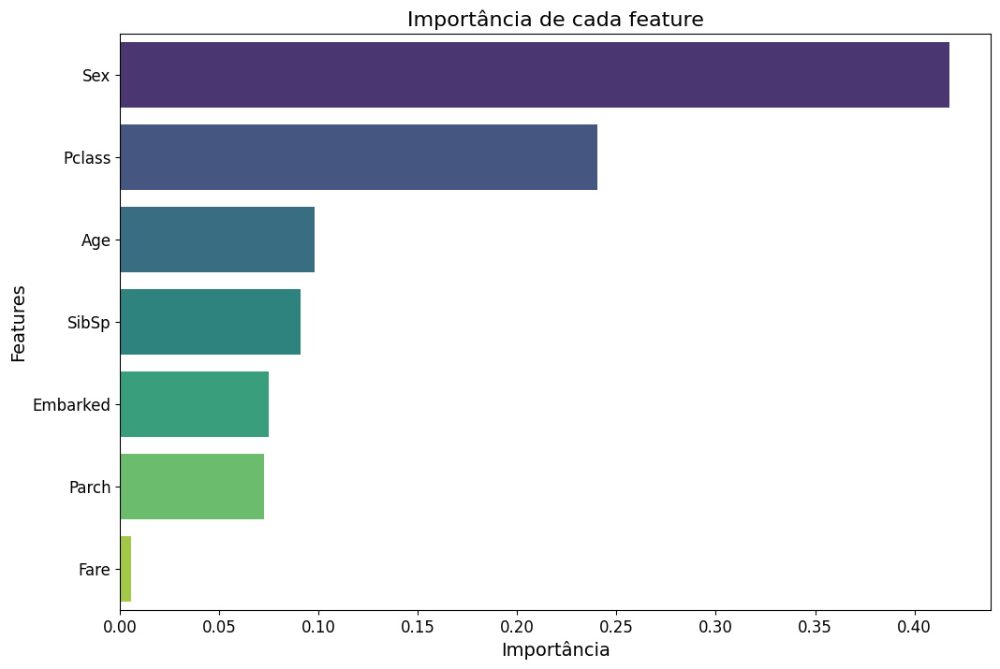


Acurácia do modelo 0.7890909090909091
Classification Report
              precision    recall  f1-score   support

           0       0.79      0.80      0.79       138
           1       0.79      0.78      0.79       137

    accuracy                           0.79       275
   macro avg       0.79      0.79      0.79       275
weighted avg       0.79      0.79      0.79       275

---------------------------------------------------
Gráfico de curva de aprendizado parametros padrões (1 camada):


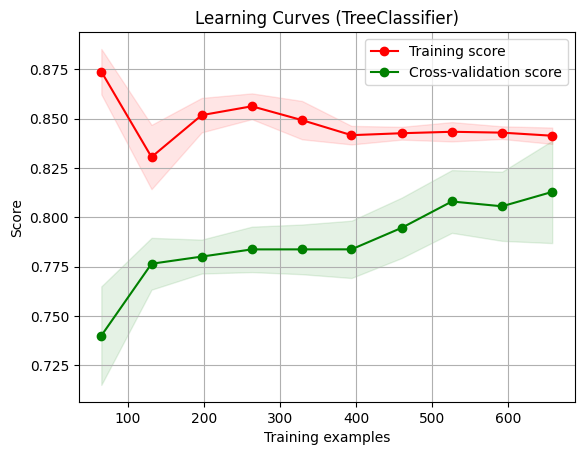

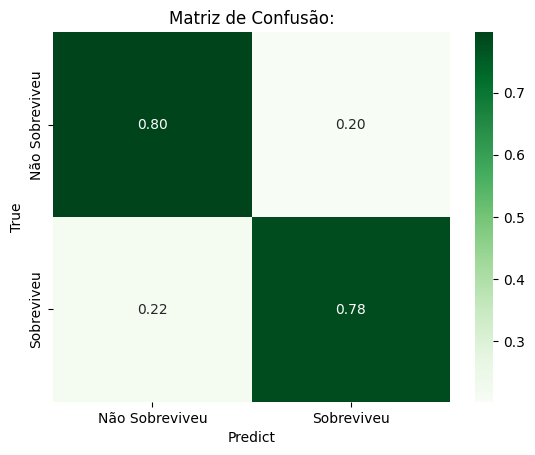

In [ ]:
rfbp_model = randomForestBestParams(X_train, y_train)
rfbp_model.fit(X_train, y_train)
plot_feature_importances(rfbp_model, X_train)
infoClassificador(rfbp_model, y_test, X_test)

#Validação do Treinamento

Vale ressaltar que utilizamos processos de tentativas e análises. Foram atribuídas vários testes sobre os tratamentos e otimização do modelo.

Dessa forma, utilizado o agrupamento comum dos dados de Fare com o tratamento das idades com regressão linear, e os valores de parametro padrão do modelo, obtivemos um melhor resultado.